In [1]:

import numpy as np
import torch
import random
from collections import deque
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import datetime
import pickle
import math
import matplotlib.pyplot as plt

In [2]:
def plot_learning_curve(x, scores, figure_file):
    running_avg_score = np.zeros(len(scores))
    for i in range(len(running_avg_score)):
        running_avg_score[i] = np.mean(scores[max(0, i-100):(i+1)])
    plt.plot(x, running_avg_score, '-b')
    plt.title('Média móvel das últimas 100 pontuações')
    plt.savefig(figure_file)

def plot_success_curve(x, successes, figure_file):
    running_success_rate = np.zeros(len(successes))
    for i in range(len(running_success_rate)):
        running_success_rate[i] = np.mean(successes[max(0, i-50):(i+1)])
    plt.plot(x, running_success_rate, '-g')
    plt.title('Taxa de sucesso dos últimos 50 episódios')
    plt.savefig(figure_file)

def plot_step_curve(x, steps, figure_file):
    running_step_avg = np.zeros(len(steps))
    for i in range(len(running_step_avg)):
        running_step_avg[i] = np.mean(steps[max(0, i-200):(i+1)])
    plt.plot(x, running_step_avg, '-g')
    plt.title('Média móvel da duração dos últimos 200 episódios')
    plt.savefig(figure_file)

In [3]:
import mujoco
import mediapy as media
import random

class MujocoEnv1_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 25
        self.name = "MujocoEnv-v1-0"
        self.theta1 = 0
        self.theta2 = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.05
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.data.qpos[0:3] = [-1,-1,2.5]
        self.data.qvel[0:3] = [2.75,1,3]
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0)
    
    def calculaTarget(self):
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        tempo_queda = (vz0+np.sqrt(np.abs(vz0**2+2*9.8*(z0-0.589))))/9.8
        targetx = x0 + tempo_queda*vx0
        targety = y0 + tempo_queda*vy0
        return targetx, targety
    def calculaDistanciaTarget(self, targetx, targety):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-targetx)**2 + (self.data.geom_xpos[9,1].copy()-targety)**2)
    def calculaDistancia(self):
        xo,yo,zo = self.data.geom_xpos[1].copy()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return np.sqrt((xo-xc)**2+(yo-yc)**2+(zo-zc)**2)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget(*self.calculaTarget())
        reward = -5*distancia
        if self.data.time > 3 or self.data.qpos[2] < 0.2:
            done = True
        if self.calculaDistancia() < 0.05:
            done = True
            reward += 200
            print('success')
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget(*self.calculaTarget())
        reward = -10*distancia**2
        if self.data.time > 3 or self.data.qpos[2] < 0.2:
            done = True
        if self.calculaDistancia() < 0.05:
            done = True
            reward += 200
            print('success')
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        x0,y0,z0 = self.data.qpos[0:3].copy()
        vx0,vy0,vz0 = self.data.qvel[0:3].copy()
        return (theta1,theta2,x0,y0,z0,vx0,vy0,vz0), reward, done

class MujocoEnv1_1:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 25
        self.name = "MujocoEnv-v1-1"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)

        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        return (xc,yc,self.targetx,self.targety)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

class MujocoEnv1_2:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 25
        self.name = "MujocoEnv-v1-2"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)

        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2
        if self.data.time > 5:
            done = True
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.targetx,self.targety), reward, done

class MujocoEnv0_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 4
        self.action_dim = 25
        self.name = "MujocoEnv-v0-0"
        self.theta1 = 0
        self.theta2 = 0
        self.targetx = 0
        self.targety = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.05
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        xc,yc,zc = self.data.geom_xpos[9].copy()
        ang = random.uniform(-np.pi,np.pi)
        r = random.uniform(1,1.7)
        self.targetx = r*np.sin(ang)
        self.targety = r*np.cos(ang)
        return (xc,yc,self.targetx,self.targety)
    
    def calculaDistanciaTarget(self, targetx, targety):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-targetx)**2 + (self.data.geom_xpos[9,1].copy()-targety)**2)
    
    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget(self.targetx,self.targety)
        reward = -2*distancia -2
        if self.data.time > 5:
            done = True
        if distancia < 0.15:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget(self.targetx,self.targety)
        reward = -2*distancia -2
        if self.data.time > 5:
            done = True
        if distancia < 0.15:
            done = True
            reward += 200
            print('success')
        xc,yc,zc = self.data.geom_xpos[9].copy()
        return (xc,yc,self.targetx,self.targety), reward, done

class MujocoEnv2_0:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 25
        self.name = "MujocoEnv-v2-0"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        print(self.data)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < 0.05:
            done = True
            reward += 200
            print('success')
            self.tfin = self.data.time
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < 0.05:
            done = True
            self.tfin = self.data.time
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

class MujocoEnv2_1:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 25
        self.name = "MujocoEnv-v2-1"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.dist = 0.45
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0

        self.angle = 0
        self.radius = 0  

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def setNextDistancia(self):
        if self.dist>0.01:
            self.dist = self.dist*0.8

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def getBolaFixa(self):
        self.x0 = self.radius*np.cos(self.angle)
        self.y0 = self.radius*np.sin(self.angle)
        self.z0 = 2.5
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 2.5
        self.calculaTarget()

    def variaPos(self,radius,angle):
        self.radius = radius
        self.angle = angle

    def resetFixo(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getBolaFixa()
        self.calculaTarget()
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        self.dist = 0.05
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.dist:
            done = True
            reward += 200
            print('success')
            self.tfin = self.data.time
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            if len(self.frames) < self.data.time * self.framerate:
                self.renderer.update_scene(self.data,camera='depth_camera0')
                pixels = self.renderer.render()
                self.frames.append(pixels)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.dist:
            done = True
            self.tfin = self.data.time
            reward += 200
            print('success')
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

class MujocoEnv2_2:
    def __init__(self):
        self.high = 1
        self.low = -1
        self.state_dim = 8
        self.action_dim = 25
        self.name = "MujocoEnv-v2-2"
        self.theta1 = 0
        self.theta2 = 0
        self.x0 = 0
        self.y0 = 0
        self.z0 = 0
        self.vx0 = 0
        self.vy0 = 0
        self.vz0 = 0
        self.targetx = 0
        self.targety = 0
        self.distlist = [1.6,0.8,0.4,0.06]
        self.distcount = 0
        self.model = mujoco.MjModel.from_xml_path("/home/kuka/Documents/ic/codigos_bons/sim_env/environmentS.xml")
        self.agent = Agent(self.state_dim,self.action_dim)

        self.data = mujoco.MjData(self.model)
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.framerate = 24
        self.frames = []
        mujoco.mj_forward(self.model, self.data)
        self.data.ctrl[6] = 0.05
        self.dt = 0.1
        self.tfin = 0
        self.successes = 0

    def calculaTarget(self):
        tempo_queda = (self.vz0+np.sqrt(self.vz0**2+2*9.8*(self.z0-0.589)))/9.8
        self.targetx = self.x0 + tempo_queda*self.vx0
        self.targety = self.y0 + tempo_queda*self.vy0

    def calculaDistanciaTarget(self):
        return np.sqrt((self.data.geom_xpos[9,0].copy()-self.targetx)**2 + (self.data.geom_xpos[9,1].copy()-self.targety)**2)

    def getGoodBola(self):
        d=0
        while d < 1 or d > 1.8:
            self.x0 = random.uniform(-1.5,1.5)
            self.y0 = random.uniform(-1.5,1.5)
            self.z0 = random.uniform(2,3)
            self.vx0 = random.uniform(-2,2)
            self.vy0 = random.uniform(-2,2)
            self.vz0 = random.uniform(2,3)
            self.calculaTarget()
            d = np.sqrt(self.targetx**2+self.targety**2)

    def reset(self):
        mujoco.mj_resetData(self.model, self.data)
        mujoco.mj_forward(self.model, self.data)
        self.frames = []
        self.data.ctrl[6] = 0.3
        self.renderer = None
        self.renderer = mujoco.Renderer(self.model, 240, 360)
        self.tfin = 0
        self.getGoodBola()
        self.calculaTarget()
        d = self.calculaDistanciaTarget()
        self.distlist = [0.75*d,0.5*d,0.25*d,0.06]
        if d < 0.06: self.distlist = [0.06]
        self.distcount = 0
        xc,yc,zc = self.data.geom_xpos[9].copy()
        self.data.qpos[0:3] = [self.x0,self.y0,self.z0]
        self.data.qvel[0:3] = [self.vx0,self.vy0,self.vz0]
        mujoco.mj_forward(self.model, self.data)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0)

    def step(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.distlist[self.distcount]:
            self.distcount += 1
            reward += 100
            self.successes += 1
        if self.distcount == len(self.distlist):
            done = True
            reward += 100
            print('success')
            self.tfin = self.data.time
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

    def rstep(self, action):
        action = self.agent.take_action(action)
        done = False
        theta1 = self.data.qpos[7].copy()
        theta2 = self.data.qpos[8].copy()
        omega1 = 3*action[0]
        omega2 = 3*action[1]
        if theta1 < -3.2:
            omega1 = max(omega1,0)
        if theta1 > 3.2:
            omega1 = min(omega1,0)
        if theta2 > -0.1:
            omega2 = min(omega2,0)
        if theta2 < -1.2:
            omega2 = max(omega2,0)
        self.data.ctrl[0:6] = [omega1,omega2/2,-omega2,0,omega2/2,0]
        nextt = self.data.time + self.dt
        while self.data.time < nextt:
            mujoco.mj_step(self.model, self.data)
            ...
        distancia = self.calculaDistanciaTarget()
        reward = -2*distancia-2-distancia**2
        if self.data.time > 5:
            done = True
            self.tfin = self.data.time
        if distancia < self.distlist[self.distcount]:
            self.distcount += 1
            reward += 100
            self.successes += 1
        if self.distcount == len(self.distlist):
            done = True
            reward += 100
            print('success')
            self.tfin = self.data.time
            self.data.ctrl[0:6] = [0,0,0,0,0,0]
            while self.data.time < 5:
                mujoco.mj_step(self.model, self.data)
                if len(self.frames) < self.data.time * self.framerate:
                    self.renderer.update_scene(self.data,camera='depth_camera0')
                    pixels = self.renderer.render()
                    self.frames.append(pixels)
        self.theta1 = self.data.qpos[7]
        self.theta2 = self.data.qpos[8]
        return (self.theta1,self.theta2,self.x0,self.y0,self.z0,self.vx0,self.vy0,self.vz0), reward, done

In [4]:
MODEL_FILE = "./ddqn_mujoco_model"
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

class ExperienceReplay:
    def __init__(self, buffer_size):
        self.buffer = deque(maxlen=buffer_size)

    def __len__(self):
        return len(self.buffer)

    # Add a transition to the memory by basic SARNS convention. 
    def store_transition(self, state, action, reward, new_state, done):
        # If buffer is abuot to overflow, begin rewriting existing memory? 
        self.buffer.append((state, action, reward, new_state, done))

    # Sample only the memory that has been stored. Samples BATCH
    # amount of samples. 
    def sample(self):
        sample = random.sample(self.buffer, BATCH_SIZE)
        states, actions, rewards, next_states, dones = zip(*sample)
        #print ("actions",actions)
        states = torch.tensor(states).float().to(DEVICE)
        actions = torch.stack(actions).long().to(DEVICE)
        rewards = torch.from_numpy(np.array(rewards, dtype=np.float32).reshape(-1, 1)).to(DEVICE)
        next_states = torch.tensor(next_states).float().to(DEVICE)
        dones = torch.from_numpy(np.array(dones, dtype=np.uint8).reshape(-1, 1)).float().to(DEVICE)
        return (states, actions, rewards, next_states, dones)

class QNetwork(nn.Module):
    def __init__(self, state_dim, action_dim):
        super(QNetwork, self).__init__()
        # Make a simple 3 later linear network
        self.l1 = nn.Linear(state_dim, 512)
        self.l2 = nn.Linear(512, 256)
        self.l3 = nn.Linear(256, action_dim)
        #self.max_action = max_action

    def forward(self, state):
        x = F.relu(self.l1(state))
        x = F.relu(self.l2(x))
        #x = self.max_action * torch.tanh(self.l3(x))
        return self.l3(x)

class Agent():
    # Initialize the agent
    def __init__(self, state_dim, action_dim):
        self.memory = ExperienceReplay(MEM_SIZE)
        self.action_dim = action_dim
        self.main_model = QNetwork(state_dim, action_dim).to(DEVICE)
        self.target_model = QNetwork(state_dim, action_dim).to(DEVICE)
        self.optimizer = optim.Adam(self.main_model.parameters(), lr=LR)
        self.eps = 1
        self.eps_decay = 0.999
        self.eps_min = 0.01

        # Target model will be a copy of the main model and will not be trained
        self.target_model.load_state_dict(self.main_model.state_dict())
        self.target_model.eval()

    # Agent saves its experiences and learn
    def step(self, state, action, reward, new_state, done):
        # Stores the transition into Experience Replay
        self.memory.store_transition(state, action, reward, new_state, done)

        # Agent will only learn when there are enough experiences
        if len(self.memory) > BATCH_SIZE:
            self.learn()

    # Agent learns
    def learn(self):
        # Sample random minibatch of transitions from Experience Replay
        state, action, reward, new_state, done = self.memory.sample()
        #print("state",state,len(state),"\n action",action,len(action))
      
        #print ("target",self.main_model(state))
        # Computes Q(s_{curr},a') then chooses columns of actions that were taken for each batch
        q_eval = self.main_model(state).gather(1,action.unsqueeze(1))
        #print("a",self.main_model(state)[1],action[1],q_eval[1])

        # Clone the model and use it to generate Q learning targets for the main model
        # Also predicts the max Q value for the next state
        #print ("target",self.main_model(state))
        q_next = self.target_model(new_state).detach().max(1)[0].unsqueeze(1)
        #print("b",self.target_model(new_state)[1],q_next[1])

        # Q learning targets = r if next state is terminal or
        # Q learning targets = r + GAMMA*(Q(s_{next},a')) if next state is not terminal
        q_target = reward + GAMMA*(q_next) *(1-done)

        # Compute MSE loss
        loss = F.mse_loss(q_eval, q_target)

        # Stochastic gradient descent on the loss function and does backpropragation
        self.optimizer.zero_grad()
        loss.backward()
        '''for param in self.main_model.parameters():
            # Clip the error term to be between -1 and 1
            param.grad.data.clamp_(-1,1)'''
        self.optimizer.step()

    def decrement_epsilon(self):
        self.eps *= self.eps_decay 
        if self.eps < self.eps_min:
            self.eps = self.eps_min

    # Action chosen is either a random action or based on the Bellman Equation
    def take_action(self, action):
        quinary = np.base_repr(action, base=5)  # Representação em base 5
        quinary = quinary.zfill(2) 
        action_array = np.zeros(2)
        mapping = {'0': -1.1, '1': -1/6, '2': 0, '3': 1/6, '4': 1.1}
        for i, n in enumerate(quinary):
            action_array[i] = mapping[n] 
        return action_array
    
    def choose_action(self, state):
        # With probability EPSILON, select a random action
        #print (state)
        if np.random.random() < self.eps:
            #return torch.from_numpy(self.action_space.sample())
            acao = random.randint(0,8)
            
        # Otherwise select the action with the highest Q value
        else: 
            #print (state)
            state = torch.FloatTensor(np.array(state).reshape(1,-1)).to(DEVICE)
            #print ("state",state)
            
            # action that maximizes Q*(s',a';THETA)  
            with torch.no_grad():
                acao = self.main_model(state).max(1)[1].item()
                #print ("escolhe",self.main_model(state),acao)
        return acao
    
    def soft_update_target_model(self, tau):
        target_model_state_dict = self.target_model.state_dict()
        main_model_state_dict = self.main_model.state_dict()
        
        for key in main_model_state_dict:
            target_model_state_dict[key] = main_model_state_dict[key] * tau + target_model_state_dict[key] * (1 - tau)
        
        self.target_model.load_state_dict(target_model_state_dict)


def save_model(model, path):
    torch.save(model.state_dict(), path)

def load_model(model, path):
    model.load_state_dict(torch.load(path))
    return model

def replay_actions(env, actions):
    done = False
    state = env.reset()
    for action in actions:
        env.render()
        env.step(action)
    env.close()

def store_actions(actions, path):
    actions_file = open(path,'wb')
    pickle.dump(actions, actions_file)
    actions_file.close()

def load_actions(path):
    actions_file = open(path,'rb')
    actions = pickle.load(actions_file)
    actions_file.close()

    return actions

In [5]:
# Hyperparameters
N_GAMES = 30001
MEM_SIZE = 100000
BATCH_SIZE = 32
TARGET_UPDATE = 4
GAMMA = 0.99
TAU = 0.005
LR = 1e-4


In [ ]:
def main():
    plt.ion()
    env = MujocoEnv2_0()
    state_dim = env.state_dim
    action_dim = env.action_dim
    agent = Agent(state_dim, action_dim)

    load = input("load from model? [y/n]: ")
    
    filename = 'DDQN_mujoco'
    figure_file_score = 'plots/' + filename + '_score.png'
    figure_file_catchrate = 'plots/' + filename + '_catchrate.png'
    figure_file_steps = 'plots/' + filename + '_steps.png'

    if load == "y":
        agent.main_model = load_model(agent.main_model, MODEL_FILE)
        agent.target_model = load_model(agent.main_model, MODEL_FILE)
        actions = load_actions(MODEL_FILE+'_actions')
        agent.eps = agent.eps_min

    max_score = -10000
    max_game = 0
    scores = []
    start = datetime.datetime.now()
    
    step_history = []
    score_history = []
    success_history = []

    for game in range(N_GAMES):
        done = False
        score = 0
        success = 0
        observation = env.reset()
        #print(observation)
        game_actions = [] # actions taken during this game
        episode_start = datetime.datetime.now()

        if game%500 != 499:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.step(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
        else:
            while not done:
                action = agent.choose_action(observation)
                observation_, reward, done = env.rstep(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
            media.show_video(env.frames, fps=env.framerate)

        # Update variables each game
        agent.decrement_epsilon()
        episode_end = datetime.datetime.now()
        elapsed = episode_end - episode_start
        scores.append(score)
        avg_score = np.mean(scores[-100:])
        
        step_history.append(env.tfin)
        score_history.append(score)
        success_history.append(success)

        # Checks if the max score has been beaten
        if score > max_score:
            max_score = score
            max_game = game

            save_model(agent.main_model, MODEL_FILE)
            store_actions(game_actions, MODEL_FILE+'_actions')

        print("eps:",agent.eps)
        print('game:', game)
        print('steps',env.tfin)
        print('reward:', str(score))
        print("max reward:", str(max_score), "at game", str(max_game))
        print('average score for the last 100 games:', avg_score)
        print('time:', str(elapsed.total_seconds()),'seconds')
        print()

    # After going through N_GAMES
    end = datetime.datetime.now()
    elapsed = end - start

    print('Total time:',elapsed.total_seconds(), 'seconds')
    
    x = [i+1 for i in range(N_GAMES)]
    %matplotlib inline
    plt.figure('learning')
    plot_learning_curve(x, score_history, figure_file_score)
    plt.figure('catching')
    plot_success_curve(x, success_history, figure_file_catchrate)
    plt.figure('steps')
    plot_step_curve(x, step_history, figure_file_steps)

    scores_file = open(MODEL_FILE+'_scores','wb')
    pickle.dump(scores, scores_file)
    scores_file.close()

main()

eps: 0.999
game: 0
reward: -585.4038342847643
average score for the last 100 games: -585.4038342847643
partial success avg 0.00  dist 0.45
time: 0.761613 seconds

eps: 0.998001
game: 1
reward: -395.74019110625557
average score for the last 100 games: -490.57201269550995
partial success avg 0.00  dist 0.45
time: 0.3781 seconds

eps: 0.997002999
game: 2
reward: -468.6505547046969
average score for the last 100 games: -483.2648600319056
partial success avg 0.00  dist 0.45
time: 0.479734 seconds

success
eps: 0.996005996001
game: 3
reward: 197.31505217516136
average score for the last 100 games: -313.11988198013887
partial success avg 0.25  dist 0.45
time: 0.007192 seconds

eps: 0.995009990004999
game: 4
reward: -558.7040674060447
average score for the last 100 games: -362.23671906532
partial success avg 0.20  dist 0.45
time: 0.397615 seconds

eps: 0.994014980014994
game: 5
reward: -731.2312884144454
average score for the last 100 games: -423.73581395684096
partial success avg 0.17  dist 0

eps: 0.6057725659163237
game: 500
reward: 173.5245884746928
average score for the last 100 games: -246.1732663244664
partial success avg 0.37  dist 0.45
time: 0.620745 seconds

success
eps: 0.6051667933504074
game: 501
reward: 197.09641889287457
average score for the last 100 games: -244.76816541376402
partial success avg 0.37  dist 0.45
time: 0.008213 seconds

eps: 0.6045616265570569
game: 502
reward: -587.816064208074
average score for the last 100 games: -246.3453463135167
partial success avg 0.37  dist 0.45
time: 0.440649 seconds

success
eps: 0.6039570649304998
game: 503
reward: 53.67413244940417
average score for the last 100 games: -247.35562449102105
partial success avg 0.37  dist 0.45
time: 0.071002 seconds

success
eps: 0.6033531078655693
game: 504
reward: 140.11219685441887
average score for the last 100 games: -237.83598397049343
partial success avg 0.38  dist 0.45
time: 0.047587 seconds

eps: 0.6027497547577038
game: 505
reward: -336.6572096737665
average score for the las

eps: 0.36732772934619257
game: 1000
reward: 111.26260293129916
average score for the last 100 games: -12.842738337650133
partial success avg 0.69  dist 0.45
time: 0.770564 seconds

success
eps: 0.3669604016168464
game: 1001
reward: 72.72934047411036
average score for the last 100 games: -9.669232306220202
partial success avg 0.70  dist 0.45
time: 0.124106 seconds

eps: 0.3665934412152296
game: 1002
reward: -295.4852415230545
average score for the last 100 games: -13.538574197898559
partial success avg 0.69  dist 0.45
time: 0.499041 seconds

success
eps: 0.3662268477740143
game: 1003
reward: -11.479275422700908
average score for the last 100 games: -14.599680478529217
partial success avg 0.69  dist 0.45
time: 0.251791 seconds

success
eps: 0.36586062092624033
game: 1004
reward: 138.6820351441196
average score for the last 100 games: -14.57476787439643
partial success avg 0.69  dist 0.45
time: 0.062116 seconds

success
eps: 0.3654947603053141
game: 1005
reward: 61.779031069431284
average

eps: 0.22273980093919937
game: 1500
reward: 166.24526687244554
average score for the last 100 games: 65.81701816014589
partial success avg 0.82  dist 0.45
time: 0.5999 seconds

success
eps: 0.22251706113826017
game: 1501
reward: 90.01334208820774
average score for the last 100 games: 64.81352708509844
partial success avg 0.82  dist 0.45
time: 0.066538 seconds

success
eps: 0.2222945440771219
game: 1502
reward: 127.7752984743354
average score for the last 100 games: 64.78820829221318
partial success avg 0.82  dist 0.45
time: 0.099085 seconds

eps: 0.22207224953304477
game: 1503
reward: -303.7037699332214
average score for the last 100 games: 59.932941534342675
partial success avg 0.81  dist 0.45
time: 0.436073 seconds

eps: 0.22185017728351172
game: 1504
reward: -231.55733006949853
average score for the last 100 games: 55.788008776444485
partial success avg 0.80  dist 0.45
time: 0.568457 seconds

success
eps: 0.2216283271062282
game: 1505
reward: 167.9113242678554
average score for the 

eps: 0.13506472547210188
game: 2000
reward: 197.36939962771737
average score for the last 100 games: 52.3439118239746
partial success avg 0.78  dist 0.45
time: 0.616619 seconds

success
eps: 0.1349296607466298
game: 2001
reward: 181.26919374754067
average score for the last 100 games: 52.746585959457406
partial success avg 0.78  dist 0.45
time: 0.035752 seconds

success
eps: 0.13479473108588316
game: 2002
reward: 196.91215092363115
average score for the last 100 games: 52.745622931141526
partial success avg 0.78  dist 0.45
time: 0.007688 seconds

success
eps: 0.13465993635479728
game: 2003
reward: 74.95112824794805
average score for the last 100 games: 51.71416363697367
partial success avg 0.78  dist 0.45
time: 0.145257 seconds

success
eps: 0.13452527641844247
game: 2004
reward: 196.95088609659055
average score for the last 100 games: 52.1073781888243
partial success avg 0.78  dist 0.45
time: 0.008474 seconds

success
eps: 0.13439075114202403
game: 2005
reward: 171.35982305376018
aver

/home/kuka/miniconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/kuka/miniconda3/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


eps: 0.3067940132148994
game: 2231
reward: -373.39687453684377
average score for the last 100 games: 110.89953018500522
partial success avg 0.50  dist 0.36
time: 0.374934 seconds

success
eps: 0.30648721920168454
game: 2232
reward: 179.2258732278796
average score for the last 100 games: 110.7995020820705
partial success avg 0.67  dist 0.36
time: 0.032187 seconds

eps: 0.30618073198248286
game: 2233
reward: -366.38017997669164
average score for the last 100 games: 105.42642906584697
partial success avg 0.50  dist 0.36
time: 0.483258 seconds

eps: 0.3058745512505004
game: 2234
reward: -231.7802322509123
average score for the last 100 games: 101.13632335321192
partial success avg 0.40  dist 0.36
time: 0.438712 seconds

success
eps: 0.3055686766992499
game: 2235
reward: 189.11351960621218
average score for the last 100 games: 101.4261717221877
partial success avg 0.50  dist 0.36
time: 0.020454 seconds

success
eps: 0.3052631080225507
game: 2236
reward: 137.23065913515896
average score for 

eps: 0.23440302570740817
game: 2500
reward: 165.9410035881647
average score for the last 100 games: 61.340577447164215
partial success avg 0.80  dist 0.36
time: 0.669879 seconds

success
eps: 0.23416862268170077
game: 2501
reward: 189.32053418471816
average score for the last 100 games: 61.48968758847276
partial success avg 0.80  dist 0.36
time: 0.02244 seconds

success
eps: 0.23393445405901908
game: 2502
reward: 183.16051268607362
average score for the last 100 games: 62.05911140212982
partial success avg 0.80  dist 0.36
time: 0.028333 seconds

success
eps: 0.23370051960496005
game: 2503
reward: 102.4235965205606
average score for the last 100 games: 65.70438289782606
partial success avg 0.81  dist 0.36
time: 0.063712 seconds

success
eps: 0.23346681908535508
game: 2504
reward: 180.50059522953555
average score for the last 100 games: 65.86116074462294
partial success avg 0.81  dist 0.36
time: 0.028219 seconds

success
eps: 0.23323335226626973
game: 2505
reward: 197.20008575560252
aver

eps: 0.32656832308862693
game: 3000
reward: 197.57527781416886
average score for the last 100 games: 56.49249581738232
partial success avg 0.73  dist 0.29
time: 0.657408 seconds

success
eps: 0.3262417547655383
game: 3001
reward: 188.05912407764552
average score for the last 100 games: 56.585657307578984
partial success avg 0.73  dist 0.29
time: 0.028622 seconds

success
eps: 0.32591551301077276
game: 3002
reward: 70.08792266151963
average score for the last 100 games: 55.625607008266705
partial success avg 0.73  dist 0.29
time: 0.080529 seconds

success
eps: 0.325589597497762
game: 3003
reward: 165.0818040797513
average score for the last 100 games: 55.48553138105296
partial success avg 0.74  dist 0.29
time: 0.040573 seconds

success
eps: 0.3252640079002642
game: 3004
reward: 157.91574128227603
average score for the last 100 games: 55.39640788759268
partial success avg 0.74  dist 0.29
time: 0.043588 seconds

success
eps: 0.32493874389236393
game: 3005
reward: 94.85294012362907
average

eps: 0.19802415517956806
game: 3500
reward: 163.63008526632828
average score for the last 100 games: 68.40427662692025
partial success avg 0.81  dist 0.29
time: 0.64825 seconds

success
eps: 0.1978261310243885
game: 3501
reward: 127.21317438988557
average score for the last 100 games: 68.05992904710908
partial success avg 0.81  dist 0.29
time: 0.161759 seconds

success
eps: 0.1976283048933641
game: 3502
reward: 42.00662540763142
average score for the last 100 games: 67.01070228672005
partial success avg 0.81  dist 0.29
time: 0.082551 seconds

success
eps: 0.19743067658847074
game: 3503
reward: 188.0189390599721
average score for the last 100 games: 67.19275198794891
partial success avg 0.81  dist 0.29
time: 0.030069 seconds

success
eps: 0.19723324591188227
game: 3504
reward: 170.95486950215619
average score for the last 100 games: 66.98538053845668
partial success avg 0.81  dist 0.29
time: 0.049433 seconds

success
eps: 0.19703601266597037
game: 3505
reward: 168.09674472974584
average

eps: 0.12007767827481403
game: 4000
reward: 160.56986184622932
average score for the last 100 games: 86.79343307599163
partial success avg 0.86  dist 0.29
time: 0.840822 seconds

eps: 0.11995760059653922
game: 4001
reward: -191.5275613162139
average score for the last 100 games: 83.19454782413803
partial success avg 0.85  dist 0.29
time: 0.398442 seconds

success
eps: 0.11983764299594268
game: 4002
reward: 187.79582662306055
average score for the last 100 games: 83.7865168225628
partial success avg 0.85  dist 0.29
time: 0.026777 seconds

success
eps: 0.11971780535294674
game: 4003
reward: 160.47836802977866
average score for the last 100 games: 84.60135782706595
partial success avg 0.85  dist 0.29
time: 0.047853 seconds

success
eps: 0.1195980875475938
game: 4004
reward: 158.61180017251195
average score for the last 100 games: 84.60329352867211
partial success avg 0.85  dist 0.29
time: 0.041558 seconds

success
eps: 0.1194784894600462
game: 4005
reward: 166.0867924700558
average score 

eps: 0.22949097402131272
game: 4500
reward: 185.7502553598714
average score for the last 100 games: 17.312270396277075
partial success avg 0.68  dist 0.23
time: 0.673731 seconds

success
eps: 0.2292614830472914
game: 4501
reward: 174.50073865722644
average score for the last 100 games: 17.90609710147679
partial success avg 0.68  dist 0.23
time: 0.059746 seconds

success
eps: 0.2290322215642441
game: 4502
reward: 183.0313037040423
average score for the last 100 games: 18.435855381324462
partial success avg 0.68  dist 0.23
time: 0.029294 seconds

success
eps: 0.22880318934267985
game: 4503
reward: 163.33637856853505
average score for the last 100 games: 21.953120540107587
partial success avg 0.69  dist 0.23
time: 0.07221 seconds

success
eps: 0.22857438615333717
game: 4504
reward: 197.59747601782263
average score for the last 100 games: 26.33548619727514
partial success avg 0.70  dist 0.23
time: 0.010389 seconds

success
eps: 0.22834581176718383
game: 4505
reward: 129.73634435589733
aver

eps: 0.1391584946822094
game: 5000
reward: 145.9614097585242
average score for the last 100 games: 61.60570360789792
partial success avg 0.79  dist 0.23
time: 0.662727 seconds

success
eps: 0.13901933618752718
game: 5001
reward: 156.92051695047314
average score for the last 100 games: 62.450746278847646
partial success avg 0.79  dist 0.23
time: 0.091933 seconds

success
eps: 0.13888031685133964
game: 5002
reward: 119.61460089135697
average score for the last 100 games: 62.42029385458234
partial success avg 0.79  dist 0.23
time: 0.054678 seconds

eps: 0.1387414365344883
game: 5003
reward: -432.39577273337926
average score for the last 100 games: 60.49111244079385
partial success avg 0.79  dist 0.23
time: 0.412453 seconds

success
eps: 0.1386026950979538
game: 5004
reward: 69.9573226666378
average score for the last 100 games: 60.12373026201317
partial success avg 0.79  dist 0.23
time: 0.199741 seconds

eps: 0.13846409240285584
game: 5005
reward: -193.2284263867133
average score for the 

eps: 0.08438278117386883
game: 5500
reward: 189.55349482447102
average score for the last 100 games: 76.48540200540968
partial success avg 0.82  dist 0.23
time: 0.761434 seconds

success
eps: 0.08429839839269496
game: 5501
reward: 79.65784674212239
average score for the last 100 games: 76.30839944006718
partial success avg 0.82  dist 0.23
time: 0.104956 seconds

eps: 0.08421409999430227
game: 5502
reward: -247.94646948565736
average score for the last 100 games: 72.39020090699722
partial success avg 0.81  dist 0.23
time: 0.483622 seconds

success
eps: 0.08412988589430796
game: 5503
reward: 180.37362153347962
average score for the last 100 games: 73.53646117529557
partial success avg 0.81  dist 0.23
time: 0.027813 seconds

success
eps: 0.08404575600841366
game: 5504
reward: 182.14186885086
average score for the last 100 games: 77.48038878220041
partial success avg 0.82  dist 0.23
time: 0.02928 seconds

eps: 0.08396171025240524
game: 5505
reward: -224.60636385569376
average score for the

eps: 0.051167941812662786
game: 6000
reward: 123.47135068543585
average score for the last 100 games: 49.432047791342804
partial success avg 0.74  dist 0.23
time: 0.771473 seconds

success
eps: 0.051116773870850125
game: 6001
reward: 159.35338748699337
average score for the last 100 games: 50.43223799611422
partial success avg 0.74  dist 0.23
time: 0.044333 seconds

success
eps: 0.05106565709697927
game: 6002
reward: 169.2030877911976
average score for the last 100 games: 50.23419530928827
partial success avg 0.74  dist 0.23
time: 0.056746 seconds

success
eps: 0.051014591439882295
game: 6003
reward: 116.0823994519516
average score for the last 100 games: 50.97316933848011
partial success avg 0.74  dist 0.23
time: 0.088768 seconds

success
eps: 0.05096357684844241
game: 6004
reward: 101.48231970779837
average score for the last 100 games: 51.616463872039475
partial success avg 0.74  dist 0.23
time: 0.071023 seconds

success
eps: 0.050912613271593965
game: 6005
reward: 168.7897654132214

eps: 0.03102716256708103
game: 6500
reward: 174.15144941956194
average score for the last 100 games: 59.51577544834886
partial success avg 0.75  dist 0.23
time: 0.649651 seconds

success
eps: 0.030996135404513948
game: 6501
reward: 192.20301663728338
average score for the last 100 games: 60.18387446707895
partial success avg 0.75  dist 0.23
time: 0.023776 seconds

success
eps: 0.030965139269109435
game: 6502
reward: 161.12687652428986
average score for the last 100 games: 60.61534548985839
partial success avg 0.75  dist 0.23
time: 0.070419 seconds

success
eps: 0.030934174129840324
game: 6503
reward: 191.63019577490599
average score for the last 100 games: 61.23635451996702
partial success avg 0.75  dist 0.23
time: 0.022151 seconds

success
eps: 0.030903239955710485
game: 6504
reward: 191.06560998394016
average score for the last 100 games: 61.40029947381401
partial success avg 0.75  dist 0.23
time: 0.024231 seconds

success
eps: 0.030872336715754775
game: 6505
reward: 173.031599679669

eps: 0.018814218099463053
game: 7000
reward: 191.83713068427429
average score for the last 100 games: 66.10730931733879
partial success avg 0.75  dist 0.23
time: 0.814538 seconds

eps: 0.01879540388136359
game: 7001
reward: -183.41163502659597
average score for the last 100 games: 62.3694667834111
partial success avg 0.74  dist 0.23
time: 0.421435 seconds

success
eps: 0.018776608477482224
game: 7002
reward: 174.79037955772043
average score for the last 100 games: 62.44508731398843
partial success avg 0.74  dist 0.23
time: 0.044803 seconds

success
eps: 0.018757831869004742
game: 7003
reward: 180.8984907578762
average score for the last 100 games: 66.1575990570299
partial success avg 0.75  dist 0.23
time: 0.043962 seconds

success
eps: 0.018739074037135737
game: 7004
reward: 155.86965679113655
average score for the last 100 games: 66.01967148012945
partial success avg 0.75  dist 0.23
time: 0.050092 seconds

success
eps: 0.018720334963098603
game: 7005
reward: 174.03465196733177
average

eps: 0.01140854571954061
game: 7500
reward: 156.96722156732434
average score for the last 100 games: 85.69456143492971
partial success avg 0.80  dist 0.23
time: 0.607736 seconds

success
eps: 0.01139713717382107
game: 7501
reward: 83.24237643924374
average score for the last 100 games: 85.16460305579581
partial success avg 0.80  dist 0.23
time: 0.072255 seconds

success
eps: 0.01138574003664725
game: 7502
reward: 179.28638593888965
average score for the last 100 games: 85.61412589011205
partial success avg 0.80  dist 0.23
time: 0.028447 seconds

eps: 0.011374354296610602
game: 7503
reward: -261.09044281043987
average score for the last 100 games: 81.76075965162823
partial success avg 0.79  dist 0.23
time: 0.501747 seconds

success
eps: 0.011362979942313991
game: 7504
reward: 178.14342236925108
average score for the last 100 games: 81.71358724156725
partial success avg 0.79  dist 0.23
time: 0.043679 seconds

success
eps: 0.011351616962371677
game: 7505
reward: 183.92653847643066
average

eps: 0.15231441796941741
game: 8000
reward: -168.78488333607237
average score for the last 100 games: 29.280600045190553
partial success avg 0.71  dist 0.18
time: 0.720323 seconds

eps: 0.152162103551448
game: 8001
reward: -238.5940758773022
average score for the last 100 games: 25.033847066078284
partial success avg 0.70  dist 0.18
time: 0.423523 seconds

success
eps: 0.15200994144789653
game: 8002
reward: 162.46533683628132
average score for the last 100 games: 25.354518541292997
partial success avg 0.70  dist 0.18
time: 0.076468 seconds

eps: 0.15185793150644863
game: 8003
reward: -240.92471926994912
average score for the last 100 games: 25.147544521391104
partial success avg 0.70  dist 0.18
time: 0.416057 seconds

eps: 0.15170607357494217
game: 8004
reward: -315.7444587992692
average score for the last 100 games: 20.296238657684725
partial success avg 0.69  dist 0.18
time: 0.428803 seconds

eps: 0.15155436750136722
game: 8005
reward: -229.97804294556246
average score for the last 1

eps: 0.09236025605544064
game: 8500
reward: 63.2511012349332
average score for the last 100 games: 54.519933085146114
partial success avg 0.75  dist 0.18
time: 0.828262 seconds

eps: 0.0922678957993852
game: 8501
reward: -200.58173273956834
average score for the last 100 games: 50.830455978676326
partial success avg 0.74  dist 0.18
time: 0.419101 seconds

eps: 0.09217562790358581
game: 8502
reward: -264.6522331005611
average score for the last 100 games: 50.26421960654533
partial success avg 0.74  dist 0.18
time: 0.426462 seconds

success
eps: 0.09208345227568222
game: 8503
reward: 98.35716607325887
average score for the last 100 games: 49.97526252058327
partial success avg 0.74  dist 0.18
time: 0.169581 seconds

success
eps: 0.09199136882340654
game: 8504
reward: 188.30887808087724
average score for the last 100 games: 50.39133861798001
partial success avg 0.74  dist 0.18
time: 0.029205 seconds

success
eps: 0.09189937745458314
game: 8505
reward: 164.16597901062676
average score for t

eps: 0.05600531461400698
game: 9000
reward: 150.30746607365305
average score for the last 100 games: 91.04856963086011
partial success avg 0.83  dist 0.18
time: 0.643043 seconds

eps: 0.05594930929939297
game: 9001
reward: -274.4061405683227
average score for the last 100 games: 87.37635513659606
partial success avg 0.82  dist 0.18
time: 0.47191 seconds

success
eps: 0.05589335999009358
game: 9002
reward: 188.13147247854775
average score for the last 100 games: 87.52128014571535
partial success avg 0.82  dist 0.18
time: 0.020569 seconds

success
eps: 0.055837466630103486
game: 9003
reward: 182.52488090827933
average score for the last 100 games: 88.30935013544196
partial success avg 0.82  dist 0.18
time: 0.040564 seconds

success
eps: 0.05578162916347338
game: 9004
reward: 147.38922265237437
average score for the last 100 games: 88.43186797550881
partial success avg 0.82  dist 0.18
time: 0.1257 seconds

success
eps: 0.055725847534309904
game: 9005
reward: 169.77652678196455
average sco

eps: 0.16521081431647316
game: 9500
reward: 175.4648969018611
average score for the last 100 games: 71.33304802881419
partial success avg 0.81  dist 0.15
time: 0.586193 seconds

eps: 0.1650456035021567
game: 9501
reward: -213.78463784488116
average score for the last 100 games: 71.74000447211552
partial success avg 0.81  dist 0.15
time: 0.405587 seconds

eps: 0.16488055789865452
game: 9502
reward: -248.78949292699053
average score for the last 100 games: 70.98755680954689
partial success avg 0.81  dist 0.15
time: 0.391491 seconds

eps: 0.16471567734075587
game: 9503
reward: -238.34464385611426
average score for the last 100 games: 71.31669355576668
partial success avg 0.81  dist 0.15
time: 0.394902 seconds

success
eps: 0.16455096166341512
game: 9504
reward: 106.37902437058801
average score for the last 100 games: 70.5370634700641
partial success avg 0.81  dist 0.15
time: 0.285789 seconds

success
eps: 0.1643864107017517
game: 9505
reward: 183.39195149637555
average score for the last 

eps: 0.10018035926488011
game: 10000
reward: 160.99374721070882
average score for the last 100 games: 70.57462558139441
partial success avg 0.79  dist 0.15
time: 0.610659 seconds

success
eps: 0.10008017890561523
game: 10001
reward: 195.5461287185328
average score for the last 100 games: 74.49661212096834
partial success avg 0.80  dist 0.15
time: 0.015502 seconds

success
eps: 0.09998009872670961
game: 10002
reward: 184.7723097371723
average score for the last 100 games: 75.21201657669337
partial success avg 0.80  dist 0.15
time: 0.034443 seconds

success
eps: 0.0998801186279829
game: 10003
reward: 44.94683664022037
average score for the last 100 games: 73.86071138632923
partial success avg 0.80  dist 0.15
time: 0.229377 seconds

success
eps: 0.09978023850935493
game: 10004
reward: 154.170599447884
average score for the last 100 games: 73.68958229181396
partial success avg 0.80  dist 0.15
time: 0.079669 seconds

success
eps: 0.09968045827084557
game: 10005
reward: 175.61296378571134
av

eps: 0.06074726054685233
game: 10500
reward: -194.8438325988347
average score for the last 100 games: 101.54111440850666
partial success avg 0.88  dist 0.15
time: 0.722096 seconds

success
eps: 0.06068651328630548
game: 10501
reward: 138.0753232144275
average score for the last 100 games: 101.98593128007339
partial success avg 0.88  dist 0.15
time: 0.115873 seconds

success
eps: 0.06062582677301917
game: 10502
reward: 178.11696675452163
average score for the last 100 games: 102.37389768476167
partial success avg 0.88  dist 0.15
time: 0.052706 seconds

success
eps: 0.06056520094624615
game: 10503
reward: 175.74086731304226
average score for the last 100 games: 105.69084245279439
partial success avg 0.89  dist 0.15
time: 0.069737 seconds

success
eps: 0.060504635745299906
game: 10504
reward: 116.31074007301294
average score for the last 100 games: 105.14593109404831
partial success avg 0.89  dist 0.15
time: 0.209229 seconds

success
eps: 0.06044413110955461
game: 10505
reward: 158.916125

eps: 0.1756498371617024
game: 11000
reward: 125.01509272116908
average score for the last 100 games: 79.59146380607487
partial success avg 0.85  dist 0.12
time: 0.866983 seconds

eps: 0.1754741873245407
game: 11001
reward: -154.2781288969906
average score for the last 100 games: 76.5067831466298
partial success avg 0.84  dist 0.12
time: 0.446845 seconds

success
eps: 0.17529871313721615
game: 11002
reward: 162.8475304700172
average score for the last 100 games: 77.01364927576017
partial success avg 0.84  dist 0.12
time: 0.064324 seconds

eps: 0.17512341442407894
game: 11003
reward: -205.76432745281784
average score for the last 100 games: 73.20534485848265
partial success avg 0.83  dist 0.12
time: 0.461651 seconds

success
eps: 0.17494829100965487
game: 11004
reward: 113.71199147518773
average score for the last 100 games: 74.95796081833403
partial success avg 0.83  dist 0.12
time: 0.127664 seconds

success
eps: 0.17477334271864522
game: 11005
reward: 152.1232430593311
average score fo

eps: 0.28692645975195524
game: 11500
reward: 156.92046900821794
average score for the last 100 games: 54.38725124282068
partial success avg 0.83  dist 0.09
time: 0.676836 seconds

success
eps: 0.28663953329220326
game: 11501
reward: 137.91725382971072
average score for the last 100 games: 57.65543422709824
partial success avg 0.84  dist 0.09
time: 0.071015 seconds

success
eps: 0.28635289375891104
game: 11502
reward: 164.87729111656887
average score for the last 100 games: 58.376618451331794
partial success avg 0.84  dist 0.09
time: 0.103567 seconds

success
eps: 0.28606654086515215
game: 11503
reward: 35.56774937952136
average score for the last 100 games: 58.51408492904067
partial success avg 0.84  dist 0.09
time: 0.157218 seconds

eps: 0.285780474324287
game: 11504
reward: -228.30105604225886
average score for the last 100 games: 55.02101912377358
partial success avg 0.83  dist 0.09
time: 0.424734 seconds

success
eps: 0.28549469384996273
game: 11505
reward: 154.64546547640052
avera

eps: 0.17398616391714605
game: 12000
reward: 134.43041037968433
average score for the last 100 games: 34.02736996998638
partial success avg 0.72  dist 0.09
time: 0.672639 seconds

success
eps: 0.1738121777532289
game: 12001
reward: 141.20905962128595
average score for the last 100 games: 37.49065380526467
partial success avg 0.73  dist 0.09
time: 0.084193 seconds

success
eps: 0.17363836557547568
game: 12002
reward: 38.93235070325542
average score for the last 100 games: 37.396821266393246
partial success avg 0.73  dist 0.09
time: 0.277905 seconds

success
eps: 0.17346472720990022
game: 12003
reward: 140.24521881939302
average score for the last 100 games: 37.180320814044585
partial success avg 0.73  dist 0.09
time: 0.184706 seconds

success
eps: 0.17329126248269033
game: 12004
reward: 186.57646829847624
average score for the last 100 games: 37.87858239661387
partial success avg 0.73  dist 0.09
time: 0.028199 seconds

success
eps: 0.17311797122020764
game: 12005
reward: 72.378395464135

eps: 0.105501546496524
game: 12500
reward: -180.95566808935595
average score for the last 100 games: 55.434405811161696
partial success avg 0.75  dist 0.09
time: 0.830241 seconds

success
eps: 0.10539604495002748
game: 12501
reward: 167.90496825811886
average score for the last 100 games: 55.93718711421492
partial success avg 0.75  dist 0.09
time: 0.077107 seconds

success
eps: 0.10529064890507746
game: 12502
reward: 185.0336583881232
average score for the last 100 games: 59.43572720464503
partial success avg 0.76  dist 0.09
time: 0.045128 seconds

success
eps: 0.10518535825617238
game: 12503
reward: 159.5577704273827
average score for the last 100 games: 59.437648104585016
partial success avg 0.76  dist 0.09
time: 0.075114 seconds

success
eps: 0.10508017289791621
game: 12504
reward: 158.89618023154057
average score for the last 100 games: 59.57684478761354
partial success avg 0.76  dist 0.09
time: 0.138901 seconds

eps: 0.1049750927250183
game: 12505
reward: -207.722196706056
average

eps: 0.06397391644578544
game: 13000
reward: -210.4905077631587
average score for the last 100 games: 70.33662019653246
partial success avg 0.79  dist 0.09
time: 0.69356 seconds

success
eps: 0.06390994252933965
game: 13001
reward: 111.99195491435975
average score for the last 100 games: 69.5621573719194
partial success avg 0.79  dist 0.09
time: 0.17055 seconds

success
eps: 0.06384603258681032
game: 13002
reward: 162.60476274967075
average score for the last 100 games: 70.9660775172309
partial success avg 0.79  dist 0.09
time: 0.123203 seconds

eps: 0.0637821865542235
game: 13003
reward: -203.45035582256446
average score for the last 100 games: 67.5539071270808
partial success avg 0.78  dist 0.09
time: 0.423718 seconds

success
eps: 0.06371840436766928
game: 13004
reward: 156.40254896241072
average score for the last 100 games: 70.59569546426327
partial success avg 0.79  dist 0.09
time: 0.121134 seconds

success
eps: 0.06365468596330161
game: 13005
reward: 185.89148380247252
average s

eps: 0.03879243595303291
game: 13500
reward: -132.34312299955766
average score for the last 100 games: 78.64340633360801
partial success avg 0.81  dist 0.09
time: 0.770589 seconds

eps: 0.038753643517079876
game: 13501
reward: -242.15969596460303
average score for the last 100 games: 75.40733694030015
partial success avg 0.80  dist 0.09
time: 0.465259 seconds

success
eps: 0.038714889873562794
game: 13502
reward: 159.19185368234184
average score for the last 100 games: 75.35848967303687
partial success avg 0.80  dist 0.09
time: 0.069597 seconds

success
eps: 0.03867617498368923
game: 13503
reward: 65.21965977573925
average score for the last 100 games: 74.1096726481484
partial success avg 0.80  dist 0.09
time: 0.091745 seconds

success
eps: 0.03863749880870554
game: 13504
reward: 133.0031949177444
average score for the last 100 games: 73.79517647373794
partial success avg 0.80  dist 0.09
time: 0.20043 seconds

eps: 0.038598861309896836
game: 13505
reward: -151.18440867067832
average sc

eps: 0.02352291638179516
game: 14000
reward: 126.09466339617866
average score for the last 100 games: 58.97910608003227
partial success avg 0.74  dist 0.09
time: 0.864856 seconds

success
eps: 0.023499393465413364
game: 14001
reward: 167.37720235000228
average score for the last 100 games: 59.00148265857309
partial success avg 0.74  dist 0.09
time: 0.054221 seconds

success
eps: 0.02347589407194795
game: 14002
reward: 151.02811833054702
average score for the last 100 games: 58.82953598508262
partial success avg 0.74  dist 0.09
time: 0.167255 seconds

success
eps: 0.023452418177876005
game: 14003
reward: 150.7664185754213
average score for the last 100 games: 58.85739881197533
partial success avg 0.74  dist 0.09
time: 0.053747 seconds

success
eps: 0.02342896575969813
game: 14004
reward: 96.22572636811307
average score for the last 100 games: 61.92366030156911
partial success avg 0.75  dist 0.09
time: 0.365482 seconds

success
eps: 0.023405536793938433
game: 14005
reward: 161.7716870353

eps: 0.20873875009106982
game: 14500
reward: 110.61225143392056
average score for the last 100 games: 98.05637572504227
partial success avg 0.68  dist 0.08
time: 0.712241 seconds

success
eps: 0.20853001134097876
game: 14501
reward: 171.929048697275
average score for the last 100 games: 98.22137199004774
partial success avg 0.69  dist 0.08
time: 0.058065 seconds

eps: 0.2083214813296378
game: 14502
reward: -310.772018007141
average score for the last 100 games: 93.92513929379012
partial success avg 0.67  dist 0.08
time: 0.412314 seconds

eps: 0.20811315984830817
game: 14503
reward: -190.05881170310855
average score for the last 100 games: 90.22440885633355
partial success avg 0.65  dist 0.08
time: 0.441332 seconds

success
eps: 0.20790504668845985
game: 14504
reward: 71.35600888993672
average score for the last 100 games: 90.58446918776899
partial success avg 0.66  dist 0.08
time: 0.095093 seconds

eps: 0.2076971416417714
game: 14505
reward: -134.53893341957112
average score for the la

eps: 0.12657478303186542
game: 15000
reward: 143.71035751547984
average score for the last 100 games: 85.96030821689453
partial success avg 0.87  dist 0.08
time: 0.648743 seconds

success
eps: 0.12644820824883357
game: 15001
reward: 179.58997695211724
average score for the last 100 games: 86.98231516936838
partial success avg 0.87  dist 0.08
time: 0.051334 seconds

success
eps: 0.12632176004058474
game: 15002
reward: 79.24713657134666
average score for the last 100 games: 86.11810526975532
partial success avg 0.87  dist 0.08
time: 0.203132 seconds

success
eps: 0.12619543828054414
game: 15003
reward: 63.903194132980786
average score for the last 100 games: 85.00434096730832
partial success avg 0.87  dist 0.08
time: 0.197316 seconds

success
eps: 0.1260692428422636
game: 15004
reward: 97.24770673449154
average score for the last 100 games: 85.00502173141693
partial success avg 0.87  dist 0.08
time: 0.159992 seconds

success
eps: 0.12594317359942134
game: 15005
reward: 115.63847856469916

eps: 0.23017313020291136
game: 15500
reward: 173.93681662547752
average score for the last 100 games: 8.407587454371146
partial success avg 0.63  dist 0.06
time: 0.794361 seconds

success
eps: 0.22994295707270845
game: 15501
reward: 166.95120615777233
average score for the last 100 games: 8.938132545584898
partial success avg 0.63  dist 0.06
time: 0.072954 seconds

success
eps: 0.22971301411563574
game: 15502
reward: 165.1241742345698
average score for the last 100 games: 9.747315600158668
partial success avg 0.63  dist 0.06
time: 0.16326 seconds

success
eps: 0.2294833011015201
game: 15503
reward: 73.47554123369243
average score for the last 100 games: 9.222542549148868
partial success avg 0.63  dist 0.06
time: 0.231311 seconds

success
eps: 0.2292538178004186
game: 15504
reward: 169.05115883945325
average score for the last 100 games: 9.474188925557172
partial success avg 0.63  dist 0.06
time: 0.066162 seconds

eps: 0.22902456398261817
game: 15505
reward: -143.6613723758684
average s

eps: 0.13957213982783742
game: 16000
reward: 121.87348432762053
average score for the last 100 games: 56.12055925766781
partial success avg 0.78  dist 0.06
time: 0.677005 seconds

eps: 0.13943256768800957
game: 16001
reward: -130.96491168497766
average score for the last 100 games: 54.37971681864035
partial success avg 0.77  dist 0.06
time: 0.445658 seconds

success
eps: 0.13929313512032157
game: 16002
reward: 176.48012008568787
average score for the last 100 games: 54.514073182956615
partial success avg 0.77  dist 0.06
time: 0.056348 seconds

success
eps: 0.13915384198520125
game: 16003
reward: 101.46210942156748
average score for the last 100 games: 53.784131084059624
partial success avg 0.77  dist 0.06
time: 0.166811 seconds

success
eps: 0.13901468814321605
game: 16004
reward: 99.09494654768955
average score for the last 100 games: 53.71126071916394
partial success avg 0.77  dist 0.06
time: 0.416594 seconds

success
eps: 0.13887567345507282
game: 16005
reward: 103.66724084895685
av

eps: 0.08463360688082175
game: 16500
reward: 91.77448233068434
average score for the last 100 games: 50.71274740481375
partial success avg 0.72  dist 0.06
time: 0.918647 seconds

success
eps: 0.08454897327394092
game: 16501
reward: 158.72195956172666
average score for the last 100 games: 50.56418935246136
partial success avg 0.72  dist 0.06
time: 0.042883 seconds

success
eps: 0.08446442430066699
game: 16502
reward: 99.19388340317148
average score for the last 100 games: 53.014875343026304
partial success avg 0.73  dist 0.06
time: 0.141804 seconds

eps: 0.08437995987636632
game: 16503
reward: -136.75590785433937
average score for the last 100 games: 49.955268170984034
partial success avg 0.72  dist 0.06
time: 0.438075 seconds

success
eps: 0.08429557991648995
game: 16504
reward: 118.6373306784079
average score for the last 100 games: 49.39402327427699
partial success avg 0.72  dist 0.06
time: 0.124862 seconds

success
eps: 0.08421128433657346
game: 16505
reward: 132.09774847648532
aver

eps: 0.051320037240188965
game: 17000
reward: 124.39192935824133
average score for the last 100 games: 52.89866925553319
partial success avg 0.76  dist 0.06
time: 0.649579 seconds

success
eps: 0.051268717202948774
game: 17001
reward: 125.06479192539913
average score for the last 100 games: 56.24115041780095
partial success avg 0.77  dist 0.06
time: 0.225723 seconds

success
eps: 0.051217448485745824
game: 17002
reward: 187.9167218995311
average score for the last 100 games: 59.90607332844956
partial success avg 0.78  dist 0.06
time: 0.037354 seconds

success
eps: 0.051166231037260076
game: 17003
reward: 68.62292002894714
average score for the last 100 games: 62.23420202869827
partial success avg 0.79  dist 0.06
time: 0.222613 seconds

eps: 0.05111506480622282
game: 17004
reward: -204.4526192272931
average score for the last 100 games: 59.03196099536935
partial success avg 0.78  dist 0.06
time: 0.622031 seconds

eps: 0.0510639497414166
game: 17005
reward: -216.35286689230242
average sc

eps: 0.031119390031942456
game: 17500
reward: 140.97734727532426
average score for the last 100 games: 55.4207675386398
partial success avg 0.74  dist 0.06
time: 0.826176 seconds

eps: 0.031088270641910512
game: 17501
reward: -194.91048635637145
average score for the last 100 games: 55.08824084841281
partial success avg 0.74  dist 0.06
time: 0.554423 seconds

eps: 0.031057182371268602
game: 17502
reward: -208.67649400718844
average score for the last 100 games: 54.714317542581306
partial success avg 0.74  dist 0.06
time: 0.583499 seconds

success
eps: 0.031026125188897333
game: 17503
reward: 167.8292520757564
average score for the last 100 games: 57.70623495619378
partial success avg 0.75  dist 0.06
time: 0.085857 seconds

success
eps: 0.030995099063708436
game: 17504
reward: 91.59311707376676
average score for the last 100 games: 57.16447973566542
partial success avg 0.75  dist 0.06
time: 0.084051 seconds

success
eps: 0.03096410396464473
game: 17505
reward: 172.7312931384048
average 

eps: 0.01887014289229297
game: 18000
reward: -124.40048737161533
average score for the last 100 games: 73.51378479064269
partial success avg 0.79  dist 0.06
time: 0.720526 seconds

success
eps: 0.01885127274940068
game: 18001
reward: 145.54780934221924
average score for the last 100 games: 73.54297079582291
partial success avg 0.79  dist 0.06
time: 0.158039 seconds

success
eps: 0.01883242147665128
game: 18002
reward: 124.82232722665691
average score for the last 100 games: 73.25104609998158
partial success avg 0.79  dist 0.06
time: 0.238576 seconds

success
eps: 0.018813589055174627
game: 18003
reward: 147.81817994807642
average score for the last 100 games: 76.01556440013354
partial success avg 0.80  dist 0.06
time: 0.072745 seconds

success
eps: 0.018794775466119452
game: 18004
reward: 134.20808386314778
average score for the last 100 games: 76.87853350267667
partial success avg 0.80  dist 0.06
time: 0.163418 seconds

success
eps: 0.01877598069065333
game: 18005
reward: 140.03524083

eps: 0.011442457336408389
game: 18500
reward: 54.04174202769144
average score for the last 100 games: 85.20991164492379
partial success avg 0.83  dist 0.06
time: 0.640344 seconds

success
eps: 0.01143101487907198
game: 18501
reward: 98.48101113717804
average score for the last 100 games: 84.74260506794879
partial success avg 0.83  dist 0.06
time: 0.353535 seconds

success
eps: 0.011419583864192909
game: 18502
reward: 51.04876924908797
average score for the last 100 games: 83.71868842177854
partial success avg 0.83  dist 0.06
time: 0.33253 seconds

success
eps: 0.011408164280328715
game: 18503
reward: 154.39574730488795
average score for the last 100 games: 83.69644928340887
partial success avg 0.83  dist 0.06
time: 0.059997 seconds

success
eps: 0.011396756116048387
game: 18504
reward: 122.9916104020603
average score for the last 100 games: 83.6656161514969
partial success avg 0.83  dist 0.06
time: 0.133001 seconds

success
eps: 0.011385359359932339
game: 18505
reward: 70.5116616056032

eps: 0.01
game: 19000
reward: 106.54389522715194
average score for the last 100 games: 74.73384757975494
partial success avg 0.80  dist 0.06
time: 0.85499 seconds

success
eps: 0.01
game: 19001
reward: 44.84930920050937
average score for the last 100 games: 73.49790466445764
partial success avg 0.80  dist 0.06
time: 0.405885 seconds

success
eps: 0.01
game: 19002
reward: 103.45045568822083
average score for the last 100 games: 72.65289738413294
partial success avg 0.80  dist 0.06
time: 0.123019 seconds

success
eps: 0.01
game: 19003
reward: 173.79075291995673
average score for the last 100 games: 73.52277778272773
partial success avg 0.80  dist 0.06
time: 0.06735 seconds

success
eps: 0.01
game: 19004
reward: 144.53987612909535
average score for the last 100 games: 73.93841483584501
partial success avg 0.80  dist 0.06
time: 0.168851 seconds

eps: 0.01
game: 19005
reward: -196.20560835243612
average score for the last 100 games: 71.08838436709816
partial success avg 0.79  dist 0.06
time

eps: 0.01
game: 19500
reward: 151.14046962286307
average score for the last 100 games: 74.59362937753832
partial success avg 0.79  dist 0.06
time: 0.685304 seconds

success
eps: 0.01
game: 19501
reward: 101.93302400034979
average score for the last 100 games: 77.39033276126034
partial success avg 0.80  dist 0.06
time: 0.254646 seconds

eps: 0.01
game: 19502
reward: -154.30566998410484
average score for the last 100 games: 78.61210145484361
partial success avg 0.80  dist 0.06
time: 0.642389 seconds

success
eps: 0.01
game: 19503
reward: 148.632255929922
average score for the last 100 games: 78.91686948471515
partial success avg 0.80  dist 0.06
time: 0.096091 seconds

success
eps: 0.01
game: 19504
reward: 109.58809987889191
average score for the last 100 games: 78.93638356441838
partial success avg 0.80  dist 0.06
time: 0.155286 seconds

success
eps: 0.01
game: 19505
reward: 145.14633365217674
average score for the last 100 games: 78.68080225887454
partial success avg 0.80  dist 0.06
tim

eps: 0.01
game: 20000
reward: 151.60347620369893
average score for the last 100 games: 72.80737920844462
partial success avg 0.78  dist 0.06
time: 0.830637 seconds

success
eps: 0.01
game: 20001
reward: 99.15839658746708
average score for the last 100 games: 72.21334564505175
partial success avg 0.78  dist 0.06
time: 0.434047 seconds

success
eps: 0.01
game: 20002
reward: 176.52334173752575
average score for the last 100 games: 72.3192829711426
partial success avg 0.78  dist 0.06
time: 0.064137 seconds

success
eps: 0.01
game: 20003
reward: 168.6151992726025
average score for the last 100 games: 72.35280289290328
partial success avg 0.78  dist 0.06
time: 0.057346 seconds

success
eps: 0.01
game: 20004
reward: 123.69672732434414
average score for the last 100 games: 71.97869718631964
partial success avg 0.78  dist 0.06
time: 0.104298 seconds

success
eps: 0.01
game: 20005
reward: 136.75627262707357
average score for the last 100 games: 71.50728402087516
partial success avg 0.78  dist 0.

eps: 0.01
game: 20500
reward: 165.7653562331604
average score for the last 100 games: 72.40103416611375
partial success avg 0.80  dist 0.06
time: 0.812253 seconds

success
eps: 0.01
game: 20501
reward: 145.915385746938
average score for the last 100 games: 75.68075053280168
partial success avg 0.81  dist 0.06
time: 0.138616 seconds

success
eps: 0.01
game: 20502
reward: 155.37570084100346
average score for the last 100 games: 75.36468857127736
partial success avg 0.81  dist 0.06
time: 0.120997 seconds

success
eps: 0.01
game: 20503
reward: 164.2894602552406
average score for the last 100 games: 78.35516517274134
partial success avg 0.82  dist 0.06
time: 0.089748 seconds

success
eps: 0.01
game: 20504
reward: 111.36699800333946
average score for the last 100 games: 77.91893763626271
partial success avg 0.82  dist 0.06
time: 0.061154 seconds

success
eps: 0.01
game: 20505
reward: 157.48157752748148
average score for the last 100 games: 77.7760313501863
partial success avg 0.82  dist 0.06

eps: 0.01
game: 21000
reward: 128.25365460744862
average score for the last 100 games: 81.16033452338294
partial success avg 0.81  dist 0.06
time: 0.607042 seconds

success
eps: 0.01
game: 21001
reward: 121.35895060346081
average score for the last 100 games: 83.86570350202263
partial success avg 0.82  dist 0.06
time: 0.207069 seconds

success
eps: 0.01
game: 21002
reward: 104.14412822377388
average score for the last 100 games: 83.62806011782698
partial success avg 0.82  dist 0.06
time: 0.321205 seconds

success
eps: 0.01
game: 21003
reward: 148.5224244429196
average score for the last 100 games: 84.19031795296874
partial success avg 0.82  dist 0.06
time: 0.199635 seconds

success
eps: 0.01
game: 21004
reward: 156.72916776172715
average score for the last 100 games: 85.07518579305071
partial success avg 0.82  dist 0.06
time: 0.142608 seconds

success
eps: 0.01
game: 21005
reward: 136.12262040363925
average score for the last 100 games: 85.9811569585834
partial success avg 0.82  dist 0

eps: 0.01
game: 21500
reward: 159.07625403635515
average score for the last 100 games: 78.2778333405434
partial success avg 0.79  dist 0.06
time: 0.615752 seconds

success
eps: 0.01
game: 21501
reward: 162.14360547331722
average score for the last 100 games: 78.64228704531618
partial success avg 0.79  dist 0.06
time: 0.103528 seconds

success
eps: 0.01
game: 21502
reward: 121.42008205276488
average score for the last 100 games: 78.65317812845217
partial success avg 0.79  dist 0.06
time: 0.088734 seconds

success
eps: 0.01
game: 21503
reward: 169.14826862881364
average score for the last 100 games: 79.14577810338984
partial success avg 0.79  dist 0.06
time: 0.072469 seconds

eps: 0.01
game: 21504
reward: -138.50732577655978
average score for the last 100 games: 76.04579035127635
partial success avg 0.78  dist 0.06
time: 0.38591 seconds

eps: 0.01
game: 21505
reward: -137.09479707119075
average score for the last 100 games: 73.02128535764479
partial success avg 0.77  dist 0.06
time: 0.40

eps: 0.01
game: 22000
reward: -171.9384157463856
average score for the last 100 games: 71.8701783441636
partial success avg 0.78  dist 0.06
time: 0.688833 seconds

success
eps: 0.01
game: 22001
reward: 155.61902189374447
average score for the last 100 games: 71.75649187139852
partial success avg 0.78  dist 0.06
time: 0.161808 seconds

success
eps: 0.01
game: 22002
reward: 81.7794385420728
average score for the last 100 games: 71.91264129627127
partial success avg 0.78  dist 0.06
time: 0.259238 seconds

success
eps: 0.01
game: 22003
reward: 108.33220255289706
average score for the last 100 games: 71.46890056140194
partial success avg 0.78  dist 0.06
time: 0.068124 seconds

success
eps: 0.01
game: 22004
reward: 110.10620287053621
average score for the last 100 games: 71.55501435553299
partial success avg 0.78  dist 0.06
time: 0.159231 seconds

eps: 0.01
game: 22005
reward: -175.35038522750398
average score for the last 100 games: 68.59333427329197
partial success avg 0.77  dist 0.06
time

eps: 0.19995313505643308
game: 22500
reward: 162.23485383630074
average score for the last 100 games: 75.51110468718223
partial success avg 0.73  dist 0.05
time: 0.64674 seconds

eps: 0.19975318192137664
game: 22501
reward: -128.22622233746227
average score for the last 100 games: 73.30428739333185
partial success avg 0.72  dist 0.05
time: 0.435899 seconds

success
eps: 0.19955342873945528
game: 22502
reward: 102.06198233831033
average score for the last 100 games: 73.32739790924566
partial success avg 0.73  dist 0.05
time: 0.07926 seconds

success
eps: 0.19935387531071583
game: 22503
reward: 179.72649616674582
average score for the last 100 games: 73.42005030221898
partial success avg 0.73  dist 0.05
time: 0.051275 seconds

success
eps: 0.1991545214354051
game: 22504
reward: 102.9870572094544
average score for the last 100 games: 72.59640427389964
partial success avg 0.74  dist 0.05
time: 0.23466 seconds

eps: 0.1989553669139697
game: 22505
reward: -133.38203364814706
average score fo

eps: 0.1212473710572058
game: 23000
reward: -213.26380738664872
average score for the last 100 games: 61.32334725080036
partial success avg 0.79  dist 0.05
time: 0.680965 seconds

success
eps: 0.1211261236861486
game: 23001
reward: 34.222084343346296
average score for the last 100 games: 60.55623890162723
partial success avg 0.79  dist 0.05
time: 0.138256 seconds

eps: 0.12100499756246245
game: 23002
reward: -132.64604993041496
average score for the last 100 games: 58.470286558614674
partial success avg 0.78  dist 0.05
time: 0.379017 seconds

eps: 0.1208839925649
game: 23003
reward: -184.45898979913613
average score for the last 100 games: 57.96714281520627
partial success avg 0.78  dist 0.05
time: 0.403087 seconds

success
eps: 0.1207631085723351
game: 23004
reward: 36.43917636015098
average score for the last 100 games: 57.62363828920736
partial success avg 0.78  dist 0.05
time: 0.385959 seconds

eps: 0.12064234546376276
game: 23005
reward: -154.44398936521424
average score for the l

eps: 0.07352185292886092
game: 23500
reward: 165.19544115583668
average score for the last 100 games: 53.723215165793825
partial success avg 0.77  dist 0.05
time: 0.61794 seconds

success
eps: 0.07344833107593206
game: 23501
reward: 161.65509541939807
average score for the last 100 games: 53.74478314314209
partial success avg 0.77  dist 0.05
time: 0.104845 seconds

success
eps: 0.07337488274485612
game: 23502
reward: 162.57724139944872
average score for the last 100 games: 53.77453211710105
partial success avg 0.77  dist 0.05
time: 0.089182 seconds

success
eps: 0.07330150786211127
game: 23503
reward: 177.10991980337513
average score for the last 100 games: 54.58440793360987
partial success avg 0.77  dist 0.05
time: 0.063028 seconds

success
eps: 0.07322820635424916
game: 23504
reward: 128.75884650757985
average score for the last 100 games: 55.744282090526085
partial success avg 0.77  dist 0.05
time: 0.198135 seconds

success
eps: 0.07315497814789491
game: 23505
reward: 112.6364944879

eps: 0.044582103603241975
game: 24000
reward: -123.50462228123261
average score for the last 100 games: 52.7074890917724
partial success avg 0.74  dist 0.05
time: 0.856528 seconds

success
eps: 0.04453752149963873
game: 24001
reward: 72.72809234718497
average score for the last 100 games: 54.78608856018127
partial success avg 0.75  dist 0.05
time: 0.174634 seconds

success
eps: 0.04449298397813909
game: 24002
reward: 39.307108565067495
average score for the last 100 games: 53.47406365414236
partial success avg 0.75  dist 0.05
time: 0.31124 seconds

success
eps: 0.04444849099416095
game: 24003
reward: 110.81570707141691
average score for the last 100 games: 53.34545830750968
partial success avg 0.75  dist 0.05
time: 0.246322 seconds

eps: 0.04440404250316679
game: 24004
reward: -135.52050179349862
average score for the last 100 games: 53.486030578022294
partial success avg 0.75  dist 0.05
time: 0.408707 seconds

success
eps: 0.044359638460663625
game: 24005
reward: 153.47333236658216
av

eps: 0.027033648942625867
game: 24500
reward: 162.5883178432128
average score for the last 100 games: 81.62665828328251
partial success avg 0.83  dist 0.05
time: 0.617775 seconds

eps: 0.027006615293683242
game: 24501
reward: -170.3171743685629
average score for the last 100 games: 78.39731240419641
partial success avg 0.82  dist 0.05
time: 0.602544 seconds

success
eps: 0.02697960867838956
game: 24502
reward: 145.1260600344559
average score for the last 100 games: 78.53156041452638
partial success avg 0.82  dist 0.05
time: 0.139843 seconds

success
eps: 0.02695262906971117
game: 24503
reward: 78.23497973716164
average score for the last 100 games: 81.67441068451872
partial success avg 0.83  dist 0.05
time: 0.226741 seconds

eps: 0.02692567644064146
game: 24504
reward: -147.43302236426658
average score for the last 100 games: 78.73379305821385
partial success avg 0.82  dist 0.05
time: 0.406688 seconds

eps: 0.02689875076420082
game: 24505
reward: -218.14538745674454
average score for t

eps: 0.01639263552157718
game: 25000
reward: -183.31330471101415
average score for the last 100 games: 42.53788971345027
partial success avg 0.71  dist 0.05
time: 0.705477 seconds

success
eps: 0.016376242886055603
game: 25001
reward: 175.36105890260941
average score for the last 100 games: 46.3660670932846
partial success avg 0.72  dist 0.05
time: 0.0682 seconds

eps: 0.016359866643169546
game: 25002
reward: -130.3359578040964
average score for the last 100 games: 46.365157728543565
partial success avg 0.72  dist 0.05
time: 0.574025 seconds

success
eps: 0.016343506776526375
game: 25003
reward: 153.90386302742817
average score for the last 100 games: 49.53705274242618
partial success avg 0.73  dist 0.05
time: 0.080892 seconds

eps: 0.01632716326974985
game: 25004
reward: -128.06438708482233
average score for the last 100 games: 46.84735943035606
partial success avg 0.72  dist 0.05
time: 0.457831 seconds

success
eps: 0.0163108361064801
game: 25005
reward: 170.51731347816627
average sc

eps: 0.01
game: 25500
reward: 142.22676073624442
average score for the last 100 games: 56.72756379090617
partial success avg 0.75  dist 0.05
time: 0.61484 seconds

success
eps: 0.01
game: 25501
reward: 41.25547188245599
average score for the last 100 games: 59.03971956692869
partial success avg 0.76  dist 0.05
time: 0.321287 seconds

success
eps: 0.01
game: 25502
reward: 44.909470981693715
average score for the last 100 games: 58.13576794733757
partial success avg 0.76  dist 0.05
time: 0.281036 seconds

success
eps: 0.01
game: 25503
reward: 142.23371958870322
average score for the last 100 games: 57.814080128782756
partial success avg 0.76  dist 0.05
time: 0.107573 seconds

success
eps: 0.01
game: 25504
reward: 153.71760943953774
average score for the last 100 games: 57.98792797295742
partial success avg 0.76  dist 0.05
time: 0.05967 seconds

eps: 0.01
game: 25505
reward: -129.8139304579457
average score for the last 100 games: 55.06131144620663
partial success avg 0.75  dist 0.05
time

eps: 0.01
game: 26000
reward: 164.42105168100463
average score for the last 100 games: 57.732092595860884
partial success avg 0.72  dist 0.05
time: 0.630731 seconds

success
eps: 0.01
game: 26001
reward: 69.06626406402995
average score for the last 100 games: 56.98684676397992
partial success avg 0.72  dist 0.05
time: 0.160088 seconds

success
eps: 0.01
game: 26002
reward: 180.9016827062497
average score for the last 100 games: 60.27802508289612
partial success avg 0.73  dist 0.05
time: 0.047707 seconds

success
eps: 0.01
game: 26003
reward: 94.3442296360206
average score for the last 100 games: 63.21483438442302
partial success avg 0.74  dist 0.05
time: 0.37481 seconds

success
eps: 0.01
game: 26004
reward: 184.6180370252872
average score for the last 100 games: 63.391824765000095
partial success avg 0.74  dist 0.05
time: 0.041891 seconds

success
eps: 0.01
game: 26005
reward: 138.49401098172785
average score for the last 100 games: 63.82973179133263
partial success avg 0.74  dist 0.0

eps: 0.15492721551459204
game: 26500
reward: 138.9713044623773
average score for the last 100 games: 38.179614475520935
partial success avg 0.75  dist 0.04
time: 0.74071 seconds

success
eps: 0.15477228829907744
game: 26501
reward: 130.51603474570774
average score for the last 100 games: 37.86566527513622
partial success avg 0.75  dist 0.04
time: 0.082999 seconds

success
eps: 0.15461751601077836
game: 26502
reward: 135.85341464332961
average score for the last 100 games: 37.77917276706494
partial success avg 0.75  dist 0.04
time: 0.082844 seconds

success
eps: 0.15446289849476758
game: 26503
reward: 106.20165832410433
average score for the last 100 games: 40.291152674132235
partial success avg 0.76  dist 0.04
time: 0.36159 seconds

success
eps: 0.1543084355962728
game: 26504
reward: 142.57827896343932
average score for the last 100 games: 43.86652749175655
partial success avg 0.77  dist 0.04
time: 0.163257 seconds

success
eps: 0.15415412716067653
game: 26505
reward: 127.2724507906399

eps: 0.09394460147401953
game: 27000
reward: -152.574198905155
average score for the last 100 games: 30.231178338287595
partial success avg 0.68  dist 0.04
time: 0.853125 seconds

success
eps: 0.09385065687254551
game: 27001
reward: 142.8696045877914
average score for the last 100 games: 32.89998217043198
partial success avg 0.69  dist 0.04
time: 0.176759 seconds

success
eps: 0.09375680621567296
game: 27002
reward: 115.22319444526114
average score for the last 100 games: 32.86941463097991
partial success avg 0.69  dist 0.04
time: 0.245409 seconds

success
eps: 0.09366304940945729
game: 27003
reward: 153.83765647286043
average score for the last 100 games: 33.588402966300826
partial success avg 0.69  dist 0.04
time: 0.144188 seconds

success
eps: 0.09356938636004783
game: 27004
reward: 175.44652020200027
average score for the last 100 games: 33.684774964720795
partial success avg 0.69  dist 0.04
time: 0.05863 seconds

success
eps: 0.09347581697368779
game: 27005
reward: 174.25368006695

eps: 0.0569660283172205
game: 27500
reward: 147.28349816029555
average score for the last 100 games: 63.25907195934211
partial success avg 0.80  dist 0.04
time: 0.679553 seconds

success
eps: 0.05690906228890328
game: 27501
reward: 174.0385775798112
average score for the last 100 games: 63.73288975141021
partial success avg 0.80  dist 0.04
time: 0.05988 seconds

success
eps: 0.056852153226614376
game: 27502
reward: 81.33849551782514
average score for the last 100 games: 63.55559330184603
partial success avg 0.80  dist 0.04
time: 0.570097 seconds

success
eps: 0.05679530107338776
game: 27503
reward: 134.49277347748227
average score for the last 100 games: 63.92354121893082
partial success avg 0.80  dist 0.04
time: 0.060857 seconds

eps: 0.056738505772314374
game: 27504
reward: -121.75052080521448
average score for the last 100 games: 62.60517379951212
partial success avg 0.79  dist 0.04
time: 0.430459 seconds

success
eps: 0.05668176726654206
game: 27505
reward: 168.2733629459372
averag

eps: 0.03454300014392853
game: 28000
reward: 56.099331613378354
average score for the last 100 games: 15.823322592060538
partial success avg 0.61  dist 0.04
time: 0.626276 seconds

success
eps: 0.0345084571437846
game: 28001
reward: 107.42854020707452
average score for the last 100 games: 18.254535031654026
partial success avg 0.62  dist 0.04
time: 0.162883 seconds

eps: 0.03447394868664082
game: 28002
reward: -125.73503806217187
average score for the last 100 games: 15.986107657497975
partial success avg 0.61  dist 0.04
time: 0.548213 seconds

success
eps: 0.034439474737954175
game: 28003
reward: 179.33825122706477
average score for the last 100 games: 19.062990398213387
partial success avg 0.62  dist 0.04
time: 0.054053 seconds

success
eps: 0.03440503526321622
game: 28004
reward: 54.438402320664665
average score for the last 100 games: 18.276010094165038
partial success avg 0.62  dist 0.04
time: 0.204145 seconds

success
eps: 0.034370630227953
game: 28005
reward: 57.574920342480056


eps: 0.020946147979615158
game: 28500
reward: -124.28916742004927
average score for the last 100 games: 45.2073232075829
partial success avg 0.74  dist 0.04
time: 0.723182 seconds

success
eps: 0.020925201831635543
game: 28501
reward: 163.96519885873343
average score for the last 100 games: 45.4320514462995
partial success avg 0.74  dist 0.04
time: 0.097927 seconds

success
eps: 0.020904276629803906
game: 28502
reward: 143.31758844356452
average score for the last 100 games: 45.31867525572947
partial success avg 0.74  dist 0.04
time: 0.14522 seconds

success
eps: 0.020883372353174102
game: 28503
reward: 176.89941677358038
average score for the last 100 games: 45.97868389380159
partial success avg 0.74  dist 0.04
time: 0.056996 seconds

eps: 0.020862488980820926
game: 28504
reward: -125.06171886055174
average score for the last 100 games: 46.26630815342491
partial success avg 0.74  dist 0.04
time: 0.47571 seconds

eps: 0.020841626491840105
game: 28505
reward: -148.61999450775104
average

eps: 0.012701303110785286
game: 29000
reward: 175.4157467064595
average score for the last 100 games: 60.88876367780792
partial success avg 0.75  dist 0.04
time: 0.817828 seconds

eps: 0.012688601807674501
game: 29001
reward: -124.12425070411878
average score for the last 100 games: 58.840697965418606
partial success avg 0.74  dist 0.04
time: 0.410697 seconds

success
eps: 0.012675913205866826
game: 29002
reward: 110.46943730947348
average score for the last 100 games: 58.111226446882426
partial success avg 0.74  dist 0.04
time: 0.2655 seconds

success
eps: 0.012663237292660959
game: 29003
reward: 155.50414056577185
average score for the last 100 games: 58.30598581162847
partial success avg 0.74  dist 0.04
time: 0.168933 seconds

success
eps: 0.012650574055368298
game: 29004
reward: 156.61951615891803
average score for the last 100 games: 58.359397761751154
partial success avg 0.74  dist 0.04
time: 0.074143 seconds

success
eps: 0.01263792348131293
game: 29005
reward: 115.3652439549553

eps: 0.01
game: 29500
reward: -123.92617488446791
average score for the last 100 games: 38.82123947032476
partial success avg 0.67  dist 0.04
time: 0.749071 seconds

success
eps: 0.01
game: 29501
reward: 151.27905989769957
average score for the last 100 games: 38.87919057642548
partial success avg 0.67  dist 0.04
time: 0.182459 seconds

success
eps: 0.01
game: 29502
reward: 120.46279561102124
average score for the last 100 games: 42.161335957548744
partial success avg 0.68  dist 0.04
time: 0.154971 seconds

success
eps: 0.01
game: 29503
reward: 156.86958453308958
average score for the last 100 games: 45.02892850082631
partial success avg 0.69  dist 0.04
time: 0.042617 seconds

success
eps: 0.01
game: 29504
reward: 172.7704202706193
average score for the last 100 games: 47.99223266320508
partial success avg 0.70  dist 0.04
time: 0.073425 seconds

eps: 0.01
game: 29505
reward: -181.71768335028423
average score for the last 100 games: 45.000654814050094
partial success avg 0.69  dist 0.04

eps: 0.01
game: 30000
reward: 79.35928960060333
average score for the last 100 games: 22.090487832416976
partial success avg 0.66  dist 0.04
time: 0.89349 seconds

Total time: 13001.631338 seconds


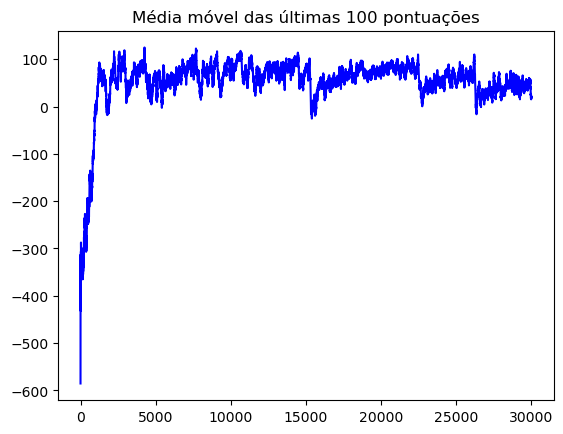

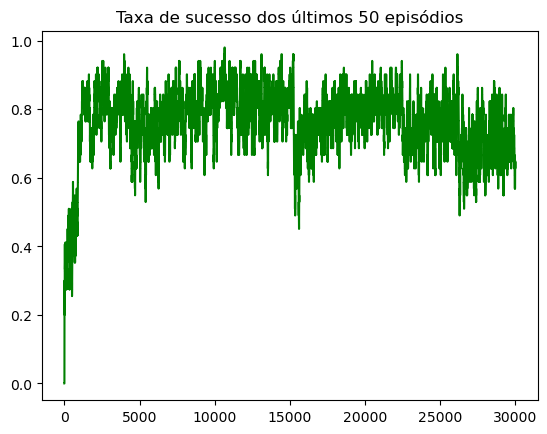

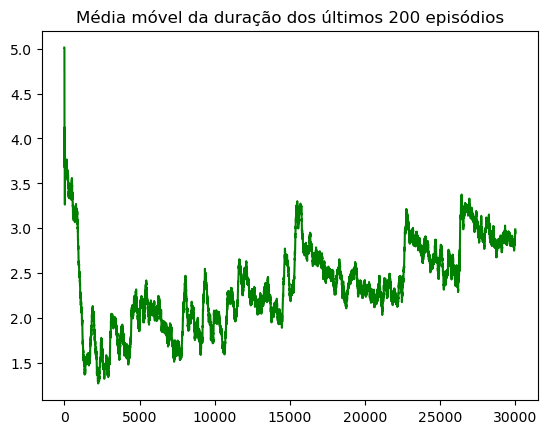

In [5]:
   ### RECOMPENSA DINÂMICA ###

# Hyperparameters
N_GAMES = 30001
MEM_SIZE = 100000
BATCH_SIZE = 32
TARGET_UPDATE = 4
GAMMA = 0.99
TAU = 0.005
LR = 1e-4

steps_taken = 0

if __name__ == '__main__':
    plt.ion()
    env = MujocoEnv2_1()
    state_dim = env.state_dim
    action_dim = env.action_dim
    agent = Agent(state_dim, action_dim)

    load = input("load from model? [y/n]: ")
    
    filename = 'DDQN_mujoco_2.5'
    figure_file_score = 'plots/' + filename + '_score.png'
    figure_file_catchrate = 'plots/' + filename + '_catchrate.png'
    figure_file_steps = 'plots/' + filename + '_steps.png'

    if load == "y":
        agent.main_model = load_model(agent.main_model, MODEL_FILE)
        agent.target_model = load_model(agent.main_model, MODEL_FILE)
        actions = load_actions(MODEL_FILE+'_actions')
        agent.eps = agent.eps_min

    max_score = -10000
    max_game = 0
    scores = []
    start = datetime.datetime.now()

    step_history = []
    score_history = []
    success_history = []
    partial_success_history = []
    next_level_points = []
    observable_games = [i for i in range(0, 30001, 500)]

    for game in range(N_GAMES):
        done = False
        score = 0
        success = 0
        observation = env.reset()
        #print(observation)
        game_actions = [] # actions taken during this game
        episode_start = datetime.datetime.now()

        if game not in observable_games:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.step(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
        else:
            while not done:
                action = agent.choose_action(observation)
                next_observation, reward, done = env.rstep(action)
                action = torch.tensor(action).long()
                agent.step(observation, action, reward, next_observation, done)
                score += float(reward)
                observation = next_observation
                if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
                if reward > 0: success = 1
            media.show_video(env.frames, fps=env.framerate)

        # Update variables each game
        agent.decrement_epsilon()
        episode_end = datetime.datetime.now()
        elapsed = episode_end - episode_start
        scores.append(score)
        avg_score = np.mean(scores[-100:])
        
        step_history.append(env.tfin)
        score_history.append(score)
        success_history.append(success)
        partial_success_history.append(success)

        # Checks if the max score has been beaten
        if score > max_score:
            max_score = score
            max_game = game

            save_model(agent.main_model, MODEL_FILE)
            store_actions(game_actions, MODEL_FILE+'_actions')

        if len(partial_success_history)>600 and np.mean(partial_success_history[-100:])>0.9:
            partial_success_history = []
            env.setNextDistancia()
            max_score = -10000
            agent.eps += 0.2
            next_level_points.append(game)
            print('NEXT LEVEL')

        print("eps:",agent.eps)
        print('game:', game)
        print('reward:', str(score))
        print('average score for the last 100 games:', avg_score)
        print('partial success avg %.2f' %np.mean(partial_success_history[-100:]), ' dist %.2f' %env.dist)
        print('time:', str(elapsed.total_seconds()),'seconds')
        print()

    # After going through N_GAMES
    end = datetime.datetime.now()
    elapsed = end - start

    print('Total time:',elapsed.total_seconds(), 'seconds')
    
    x = [i+1 for i in range(N_GAMES)]
    %matplotlib inline
    plt.figure('learning')
    plot_learning_curve(x, score_history, figure_file_score)
    plt.figure('catching')
    plot_success_curve(x, success_history, figure_file_catchrate)
    plt.figure('steps')
    plot_step_curve(x, step_history, figure_file_steps)

    scores_file = open(MODEL_FILE+'_scores','wb')
    pickle.dump(scores, scores_file)
    scores_file.close()

In [6]:
print(max_game)

28945


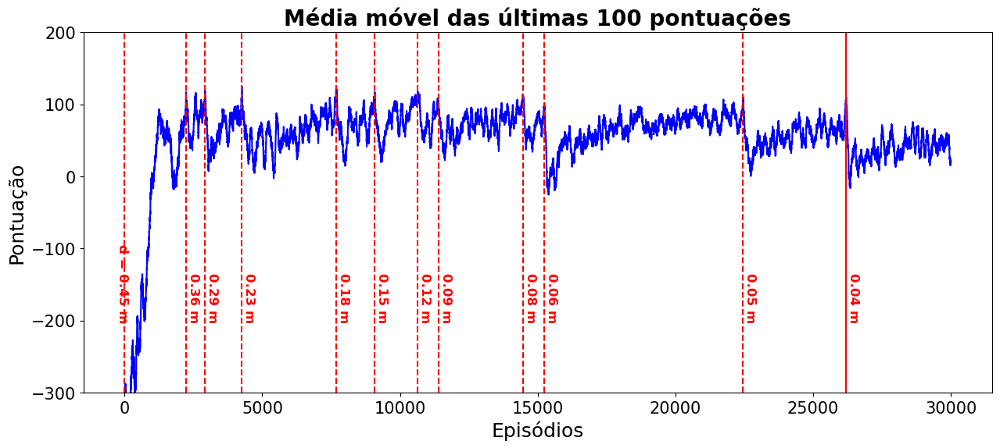

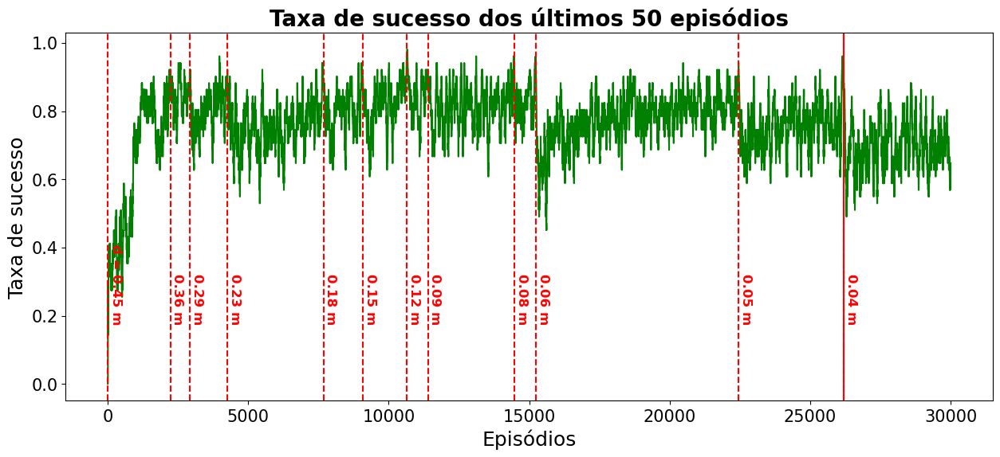

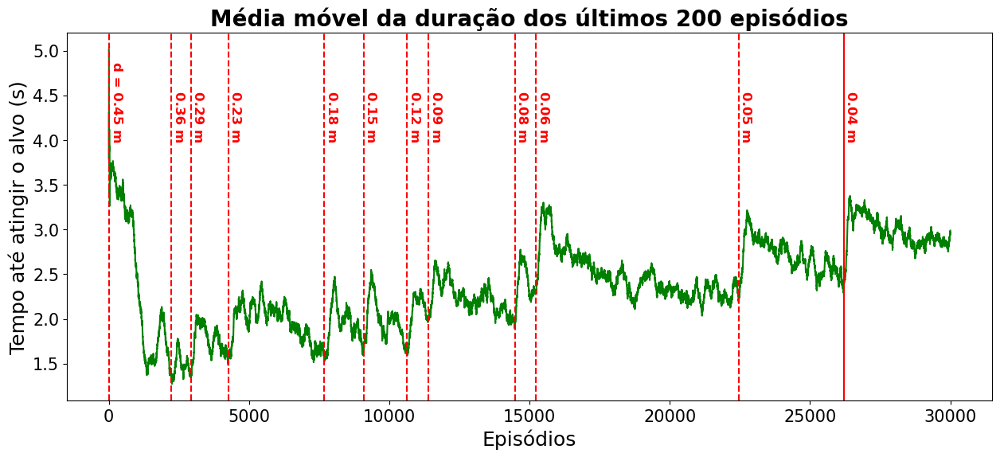

In [11]:
def plot_learning_curve(x, scores, figure_file):
    running_avg_score = np.zeros(len(scores))
    for i in range(len(running_avg_score)):
        running_avg_score[i] = np.mean(scores[max(0, i-100):(i+1)])
    plt.plot(x, running_avg_score, '-b')
    plt.ylim(-300,200)
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Pontuação',fontsize='18')
    plt.axvline(x=next_level_points[-1], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(-300,-200,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,-200,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Média móvel das últimas 100 pontuações',size='20',weight='bold')
    plt.savefig(figure_file)

def plot_success_curve(x, successes, figure_file):
    running_success_rate = np.zeros(len(successes))
    for i in range(len(running_success_rate)):
        running_success_rate[i] = np.mean(successes[max(0, i-50):(i+1)])
    plt.plot(x, running_success_rate, '-g')
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Taxa de sucesso',fontsize='18')
    plt.axvline(x=next_level_points[-1], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(80,0.18,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,0.18,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Taxa de sucesso dos últimos 50 episódios',size='20',weight='bold')
    plt.savefig(figure_file)

def plot_step_curve(x, steps, figure_file):
    running_step_avg = np.zeros(len(steps))
    for i in range(len(running_step_avg)):
        running_step_avg[i] = np.mean(steps[max(0, i-200):(i+1)])
    plt.plot(x, running_step_avg, '-g')
    plt.xticks(fontsize='15')
    plt.yticks(fontsize='15')
    plt.xlabel('Episódios',fontsize='18')
    plt.ylabel('Tempo até atingir o alvo (s)',fontsize='18')
    plt.axvline(x=next_level_points[-1], color='red')
    plt.axvline(0,color='red',linestyle='--')
    plt.text(65,4,'d = 0.45 m',rotation=-90,color='red',weight='bold',size='12')
    d = 0.45
    for p in next_level_points[:]:
        d = d*0.8
        plt.text(p+50,4,'%.2f m'%d,rotation=-90,color='red',weight='bold',size='12')
        plt.axvline(x=p, color='red', linestyle='--')
    plt.title('Média móvel da duração dos últimos 200 episódios',size='20',weight='bold')
    plt.savefig(figure_file)

x = [i+1 for i in range(30001)]
%matplotlib inline
plt.figure('learning',figsize=(15,6))
plot_learning_curve(x, score_history, figure_file_score)
plt.figure('catching',figsize=(15,6))
plot_success_curve(x, success_history, figure_file_catchrate)
plt.figure('steps',figsize=(15,6))
plot_step_curve(x, step_history, figure_file_steps)

In [24]:
save_model(agent.main_model, MODEL_FILE)
store_actions(game_actions, MODEL_FILE+'_actions')

In [12]:
plt.ion()
env = MujocoEnv2_1()
state_dim = env.state_dim
action_dim = env.action_dim
agent = Agent(state_dim, action_dim)

agent.main_model = load_model(agent.main_model, MODEL_FILE)
agent.target_model = load_model(agent.main_model, MODEL_FILE)
actions = load_actions(MODEL_FILE+'_actions')
agent.eps = agent.eps_min
success_games = []

fixedGames = []
for i in np.arange(1, 1.6, 0.1):
    for j in np.arange(0, 2*np.pi, np.pi/18):
        list = [i, j] 
        fixedGames.append(list)

for game in range(len(fixedGames)):
    env.variaPos(float(fixedGames[game][0]),float(fixedGames[game][1]))
    done = False
    score = 0
    success = 0
    observation = env.resetFixo()
    game_actions = [] # actions taken during this game

    while not done:
        action = agent.choose_action(observation)
        next_observation, reward, done = env.rstep(action)
        action = torch.tensor(action).long()
        #agent.step(observation, action, reward, next_observation, done)
        score += float(reward)
        observation = next_observation
        #if game % TARGET_UPDATE == 0: agent.soft_update_target_model(TAU)
        if reward > 0:
            success = 1

    media.show_video(env.frames, fps=env.framerate)

    print('Jogo:', game, ' \  Raio:', env.radius, ' \  Ângulo:', env.angle*180/np.pi)
    print('Recompensa:', str(score))
    print('-------------------------------------------------')
    if success: success_games.append((env.radius,env.angle))

success


Jogo: 0  \  Raio: 1.0  \  Ângulo: 0.0
Recompensa: 152.44738038206467
-------------------------------------------------
success


Jogo: 1  \  Raio: 1.0  \  Ângulo: 10.0
Recompensa: 129.90739272750133
-------------------------------------------------
success


Jogo: 2  \  Raio: 1.0  \  Ângulo: 20.0
Recompensa: 171.33766268198318
-------------------------------------------------
success


Jogo: 3  \  Raio: 1.0  \  Ângulo: 29.999999999999996
Recompensa: 118.04440676994473
-------------------------------------------------


Jogo: 4  \  Raio: 1.0  \  Ângulo: 40.0
Recompensa: -135.55856636517555
-------------------------------------------------
success


Jogo: 5  \  Raio: 1.0  \  Ângulo: 50.0
Recompensa: 138.2063577163232
-------------------------------------------------
success


Jogo: 6  \  Raio: 1.0  \  Ângulo: 59.99999999999999
Recompensa: 130.25684511344946
-------------------------------------------------
success


Jogo: 7  \  Raio: 1.0  \  Ângulo: 70.0
Recompensa: 158.13140514749395
-------------------------------------------------


Jogo: 8  \  Raio: 1.0  \  Ângulo: 80.0
Recompensa: -129.80378955019486
-------------------------------------------------
success


Jogo: 9  \  Raio: 1.0  \  Ângulo: 90.0
Recompensa: 167.464982876166
-------------------------------------------------
success


Jogo: 10  \  Raio: 1.0  \  Ângulo: 100.0
Recompensa: 88.5711098889182
-------------------------------------------------
success


Jogo: 11  \  Raio: 1.0  \  Ângulo: 110.0
Recompensa: 84.58283460301674
-------------------------------------------------
success


Jogo: 12  \  Raio: 1.0  \  Ângulo: 119.99999999999999
Recompensa: 129.8607325989832
-------------------------------------------------
success


Jogo: 13  \  Raio: 1.0  \  Ângulo: 130.0
Recompensa: 150.40107696874804
-------------------------------------------------
success


Jogo: 14  \  Raio: 1.0  \  Ângulo: 140.0
Recompensa: 136.55825643158568
-------------------------------------------------
success


Jogo: 15  \  Raio: 1.0  \  Ângulo: 150.00000000000003
Recompensa: 138.12948414501184
-------------------------------------------------
success


Jogo: 16  \  Raio: 1.0  \  Ângulo: 160.0
Recompensa: 99.57955013587303
-------------------------------------------------
success


Jogo: 17  \  Raio: 1.0  \  Ângulo: 170.0
Recompensa: 128.35429651040303
-------------------------------------------------
success


Jogo: 18  \  Raio: 1.0  \  Ângulo: 180.0
Recompensa: 19.41226385613311
-------------------------------------------------


Jogo: 19  \  Raio: 1.0  \  Ângulo: 190.0
Recompensa: -232.91153206140183
-------------------------------------------------
success


Jogo: 20  \  Raio: 1.0  \  Ângulo: 200.0
Recompensa: 96.2368106750896
-------------------------------------------------
success


Jogo: 21  \  Raio: 1.0  \  Ângulo: 209.99999999999997
Recompensa: 106.89217188637011
-------------------------------------------------


Jogo: 22  \  Raio: 1.0  \  Ângulo: 220.0
Recompensa: -160.94956347619055
-------------------------------------------------


Jogo: 23  \  Raio: 1.0  \  Ângulo: 229.99999999999997
Recompensa: -154.94337912040265
-------------------------------------------------


Jogo: 24  \  Raio: 1.0  \  Ângulo: 239.99999999999997
Recompensa: -152.00010737929975
-------------------------------------------------
success


Jogo: 25  \  Raio: 1.0  \  Ângulo: 249.99999999999997
Recompensa: 114.17487865411256
-------------------------------------------------
success


Jogo: 26  \  Raio: 1.0  \  Ângulo: 260.0
Recompensa: 90.64243692798838
-------------------------------------------------
success


Jogo: 27  \  Raio: 1.0  \  Ângulo: 270.0
Recompensa: 145.99952164945594
-------------------------------------------------
success


Jogo: 28  \  Raio: 1.0  \  Ângulo: 280.0
Recompensa: 119.63777238263759
-------------------------------------------------
success


Jogo: 29  \  Raio: 1.0  \  Ângulo: 290.0
Recompensa: 148.0647430903862
-------------------------------------------------
success


Jogo: 30  \  Raio: 1.0  \  Ângulo: 300.00000000000006
Recompensa: 141.87547090155803
-------------------------------------------------
success


Jogo: 31  \  Raio: 1.0  \  Ângulo: 310.0
Recompensa: 171.7802124195666
-------------------------------------------------
success


Jogo: 32  \  Raio: 1.0  \  Ângulo: 320.0
Recompensa: 134.21580692873752
-------------------------------------------------
success


Jogo: 33  \  Raio: 1.0  \  Ângulo: 329.99999999999994
Recompensa: 175.6634646043873
-------------------------------------------------
success


Jogo: 34  \  Raio: 1.0  \  Ângulo: 340.0
Recompensa: 170.8980938480075
-------------------------------------------------
success


Jogo: 35  \  Raio: 1.0  \  Ângulo: 350.00000000000006
Recompensa: 157.53701815099328
-------------------------------------------------
success


Jogo: 36  \  Raio: 1.1  \  Ângulo: 0.0
Recompensa: 170.07475187749793
-------------------------------------------------
success


Jogo: 37  \  Raio: 1.1  \  Ângulo: 10.0
Recompensa: 165.11271627419111
-------------------------------------------------
success


Jogo: 38  \  Raio: 1.1  \  Ângulo: 20.0
Recompensa: 163.96295960165529
-------------------------------------------------
success


Jogo: 39  \  Raio: 1.1  \  Ângulo: 29.999999999999996
Recompensa: 163.17223985442163
-------------------------------------------------
success


Jogo: 40  \  Raio: 1.1  \  Ângulo: 40.0
Recompensa: 150.21203516217304
-------------------------------------------------


Jogo: 41  \  Raio: 1.1  \  Ângulo: 50.0
Recompensa: -131.88085555535483
-------------------------------------------------
success


Jogo: 42  \  Raio: 1.1  \  Ângulo: 59.99999999999999
Recompensa: 170.48684491124067
-------------------------------------------------
success


Jogo: 43  \  Raio: 1.1  \  Ângulo: 70.0
Recompensa: 140.7604036307809
-------------------------------------------------
success


Jogo: 44  \  Raio: 1.1  \  Ângulo: 80.0
Recompensa: 164.38374351080788
-------------------------------------------------


Jogo: 45  \  Raio: 1.1  \  Ângulo: 90.0
Recompensa: -131.17364493065998
-------------------------------------------------
success


Jogo: 46  \  Raio: 1.1  \  Ângulo: 100.0
Recompensa: 155.72293169132377
-------------------------------------------------
success


Jogo: 47  \  Raio: 1.1  \  Ângulo: 110.0
Recompensa: 137.6842792830451
-------------------------------------------------
success


Jogo: 48  \  Raio: 1.1  \  Ângulo: 119.99999999999999
Recompensa: 147.4990106978522
-------------------------------------------------
success


Jogo: 49  \  Raio: 1.1  \  Ângulo: 130.0
Recompensa: 133.96967370773893
-------------------------------------------------
success


Jogo: 50  \  Raio: 1.1  \  Ângulo: 140.0
Recompensa: 135.15651625558849
-------------------------------------------------
success


Jogo: 51  \  Raio: 1.1  \  Ângulo: 150.00000000000003
Recompensa: 102.98309667953274
-------------------------------------------------
success


Jogo: 52  \  Raio: 1.1  \  Ângulo: 160.0
Recompensa: 121.56798407000326
-------------------------------------------------
success


Jogo: 53  \  Raio: 1.1  \  Ângulo: 170.0
Recompensa: 85.62783820050132
-------------------------------------------------


Jogo: 54  \  Raio: 1.1  \  Ângulo: 180.0
Recompensa: -180.15636065110925
-------------------------------------------------


Jogo: 55  \  Raio: 1.1  \  Ângulo: 190.0
Recompensa: -219.98481725003913
-------------------------------------------------


Jogo: 56  \  Raio: 1.1  \  Ângulo: 200.0
Recompensa: -181.55034396659713
-------------------------------------------------


Jogo: 57  \  Raio: 1.1  \  Ângulo: 209.99999999999997
Recompensa: -169.84818795013186
-------------------------------------------------


Jogo: 58  \  Raio: 1.1  \  Ângulo: 220.0
Recompensa: -163.08187286141018
-------------------------------------------------
success


Jogo: 59  \  Raio: 1.1  \  Ângulo: 229.99999999999997
Recompensa: 58.8889562313411
-------------------------------------------------


Jogo: 60  \  Raio: 1.1  \  Ângulo: 239.99999999999997
Recompensa: -148.91995670746994
-------------------------------------------------


Jogo: 61  \  Raio: 1.1  \  Ângulo: 249.99999999999997
Recompensa: -146.03892391637785
-------------------------------------------------


Jogo: 62  \  Raio: 1.1  \  Ângulo: 260.0
Recompensa: -146.9044195478787
-------------------------------------------------
success


Jogo: 63  \  Raio: 1.1  \  Ângulo: 270.0
Recompensa: 163.38898437872513
-------------------------------------------------
success


Jogo: 64  \  Raio: 1.1  \  Ângulo: 280.0
Recompensa: 139.86621062814083
-------------------------------------------------
success


Jogo: 65  \  Raio: 1.1  \  Ângulo: 290.0
Recompensa: 113.5976709670205
-------------------------------------------------
success


Jogo: 66  \  Raio: 1.1  \  Ângulo: 300.00000000000006
Recompensa: 165.9784917342201
-------------------------------------------------
success


Jogo: 67  \  Raio: 1.1  \  Ângulo: 310.0
Recompensa: 139.1600540523303
-------------------------------------------------
success


Jogo: 68  \  Raio: 1.1  \  Ângulo: 320.0
Recompensa: 170.1112582439799
-------------------------------------------------
success


Jogo: 69  \  Raio: 1.1  \  Ângulo: 329.99999999999994
Recompensa: 175.37742621227514
-------------------------------------------------
success


Jogo: 70  \  Raio: 1.1  \  Ângulo: 340.0
Recompensa: 102.06671760949736
-------------------------------------------------
success


Jogo: 71  \  Raio: 1.1  \  Ângulo: 350.00000000000006
Recompensa: 129.4227019415115
-------------------------------------------------
success


Jogo: 72  \  Raio: 1.2000000000000002  \  Ângulo: 0.0
Recompensa: 171.8660666565575
-------------------------------------------------
success


Jogo: 73  \  Raio: 1.2000000000000002  \  Ângulo: 10.0
Recompensa: 179.72895026756623
-------------------------------------------------
success


Jogo: 74  \  Raio: 1.2000000000000002  \  Ângulo: 20.0
Recompensa: 171.7927281463191
-------------------------------------------------
success


Jogo: 75  \  Raio: 1.2000000000000002  \  Ângulo: 29.999999999999996
Recompensa: 166.38088049805248
-------------------------------------------------
success


Jogo: 76  \  Raio: 1.2000000000000002  \  Ângulo: 40.0
Recompensa: 173.79479957175153
-------------------------------------------------
success


Jogo: 77  \  Raio: 1.2000000000000002  \  Ângulo: 50.0
Recompensa: 161.88275246680558
-------------------------------------------------
success


Jogo: 78  \  Raio: 1.2000000000000002  \  Ângulo: 59.99999999999999
Recompensa: 171.46338174398048
-------------------------------------------------


Jogo: 79  \  Raio: 1.2000000000000002  \  Ângulo: 70.0
Recompensa: -126.58672474832207
-------------------------------------------------
success


Jogo: 80  \  Raio: 1.2000000000000002  \  Ângulo: 80.0
Recompensa: 146.57487756420244
-------------------------------------------------
success


Jogo: 81  \  Raio: 1.2000000000000002  \  Ângulo: 90.0
Recompensa: 169.15779050305346
-------------------------------------------------
success


Jogo: 82  \  Raio: 1.2000000000000002  \  Ângulo: 100.0
Recompensa: 156.06856793945843
-------------------------------------------------
success


Jogo: 83  \  Raio: 1.2000000000000002  \  Ângulo: 110.0
Recompensa: 161.19443522244762
-------------------------------------------------
success


Jogo: 84  \  Raio: 1.2000000000000002  \  Ângulo: 119.99999999999999
Recompensa: 146.8756679950148
-------------------------------------------------
success


Jogo: 85  \  Raio: 1.2000000000000002  \  Ângulo: 130.0
Recompensa: 148.0037229871889
-------------------------------------------------
success


Jogo: 86  \  Raio: 1.2000000000000002  \  Ângulo: 140.0
Recompensa: 133.77178751798846
-------------------------------------------------
success


Jogo: 87  \  Raio: 1.2000000000000002  \  Ângulo: 150.00000000000003
Recompensa: 134.9810408873456
-------------------------------------------------


Jogo: 88  \  Raio: 1.2000000000000002  \  Ângulo: 160.0
Recompensa: -167.47686700947216
-------------------------------------------------
success


Jogo: 89  \  Raio: 1.2000000000000002  \  Ângulo: 170.0
Recompensa: 122.42529051136592
-------------------------------------------------
success


Jogo: 90  \  Raio: 1.2000000000000002  \  Ângulo: 180.0
Recompensa: 109.09534599644512
-------------------------------------------------


Jogo: 91  \  Raio: 1.2000000000000002  \  Ângulo: 190.0
Recompensa: -221.55249505914603
-------------------------------------------------
success


Jogo: 92  \  Raio: 1.2000000000000002  \  Ângulo: 200.0
Recompensa: 81.69568096371742
-------------------------------------------------
success


Jogo: 93  \  Raio: 1.2000000000000002  \  Ângulo: 209.99999999999997
Recompensa: 99.43590786021231
-------------------------------------------------
success


Jogo: 94  \  Raio: 1.2000000000000002  \  Ângulo: 220.0
Recompensa: 115.63283934074337
-------------------------------------------------
success


Jogo: 95  \  Raio: 1.2000000000000002  \  Ângulo: 229.99999999999997
Recompensa: 97.81524609085024
-------------------------------------------------
success


Jogo: 96  \  Raio: 1.2000000000000002  \  Ângulo: 239.99999999999997
Recompensa: 115.48442411928194
-------------------------------------------------


Jogo: 97  \  Raio: 1.2000000000000002  \  Ângulo: 249.99999999999997
Recompensa: -140.79351291114085
-------------------------------------------------


Jogo: 98  \  Raio: 1.2000000000000002  \  Ângulo: 260.0
Recompensa: -138.4475070427585
-------------------------------------------------


Jogo: 99  \  Raio: 1.2000000000000002  \  Ângulo: 270.0
Recompensa: -136.5975408067415
-------------------------------------------------
success


Jogo: 100  \  Raio: 1.2000000000000002  \  Ângulo: 280.0
Recompensa: 104.85663838635129
-------------------------------------------------
success


Jogo: 101  \  Raio: 1.2000000000000002  \  Ângulo: 290.0
Recompensa: 150.49806695388037
-------------------------------------------------
success


Jogo: 102  \  Raio: 1.2000000000000002  \  Ângulo: 300.00000000000006
Recompensa: 130.1223625779491
-------------------------------------------------
success


Jogo: 103  \  Raio: 1.2000000000000002  \  Ângulo: 310.0
Recompensa: 174.92351561549324
-------------------------------------------------


Jogo: 104  \  Raio: 1.2000000000000002  \  Ângulo: 320.0
Recompensa: -121.26399283934073
-------------------------------------------------
success


Jogo: 105  \  Raio: 1.2000000000000002  \  Ângulo: 329.99999999999994
Recompensa: 179.1274986138721
-------------------------------------------------
success


Jogo: 106  \  Raio: 1.2000000000000002  \  Ângulo: 340.0
Recompensa: 174.48823076915204
-------------------------------------------------
success


Jogo: 107  \  Raio: 1.2000000000000002  \  Ângulo: 350.00000000000006
Recompensa: 165.50117275677405
-------------------------------------------------
success


Jogo: 108  \  Raio: 1.3000000000000003  \  Ângulo: 0.0
Recompensa: 175.19734305643547
-------------------------------------------------
success


Jogo: 109  \  Raio: 1.3000000000000003  \  Ângulo: 10.0
Recompensa: 163.17937298806066
-------------------------------------------------
success


Jogo: 110  \  Raio: 1.3000000000000003  \  Ângulo: 20.0
Recompensa: 159.4408732366462
-------------------------------------------------
success


Jogo: 111  \  Raio: 1.3000000000000003  \  Ângulo: 29.999999999999996
Recompensa: 168.14680235764786
-------------------------------------------------
success


Jogo: 112  \  Raio: 1.3000000000000003  \  Ângulo: 40.0
Recompensa: 156.29563242489695
-------------------------------------------------
success


Jogo: 113  \  Raio: 1.3000000000000003  \  Ângulo: 50.0
Recompensa: 76.20683687084266
-------------------------------------------------
success


Jogo: 114  \  Raio: 1.3000000000000003  \  Ângulo: 59.99999999999999
Recompensa: 172.22450261294227
-------------------------------------------------
success


Jogo: 115  \  Raio: 1.3000000000000003  \  Ângulo: 70.0
Recompensa: 122.83652603919566
-------------------------------------------------
success


Jogo: 116  \  Raio: 1.3000000000000003  \  Ângulo: 80.0
Recompensa: 158.99854514417547
-------------------------------------------------
success


Jogo: 117  \  Raio: 1.3000000000000003  \  Ângulo: 90.0
Recompensa: 151.00984911489252
-------------------------------------------------
success


Jogo: 118  \  Raio: 1.3000000000000003  \  Ângulo: 100.0
Recompensa: 138.66075483875434
-------------------------------------------------
success


Jogo: 119  \  Raio: 1.3000000000000003  \  Ângulo: 110.0
Recompensa: 160.5966042633804
-------------------------------------------------
success


Jogo: 120  \  Raio: 1.3000000000000003  \  Ângulo: 119.99999999999999
Recompensa: 143.6391802034407
-------------------------------------------------
success


Jogo: 121  \  Raio: 1.3000000000000003  \  Ângulo: 130.0
Recompensa: 147.54588357415017
-------------------------------------------------
success


Jogo: 122  \  Raio: 1.3000000000000003  \  Ângulo: 140.0
Recompensa: 131.4408523577609
-------------------------------------------------
success


Jogo: 123  \  Raio: 1.3000000000000003  \  Ângulo: 150.00000000000003
Recompensa: 113.34645212709754
-------------------------------------------------
success


Jogo: 124  \  Raio: 1.3000000000000003  \  Ângulo: 160.0
Recompensa: 113.07194933404192
-------------------------------------------------
success


Jogo: 125  \  Raio: 1.3000000000000003  \  Ângulo: 170.0
Recompensa: 33.710305402594656
-------------------------------------------------
success


Jogo: 126  \  Raio: 1.3000000000000003  \  Ângulo: 180.0
Recompensa: 100.73271728922988
-------------------------------------------------
success


Jogo: 127  \  Raio: 1.3000000000000003  \  Ângulo: 190.0
Recompensa: 71.10275895196247
-------------------------------------------------
success


Jogo: 128  \  Raio: 1.3000000000000003  \  Ângulo: 200.0
Recompensa: 88.03271590981545
-------------------------------------------------
success


Jogo: 129  \  Raio: 1.3000000000000003  \  Ângulo: 209.99999999999997
Recompensa: 90.86165189298299
-------------------------------------------------
success


Jogo: 130  \  Raio: 1.3000000000000003  \  Ângulo: 220.0
Recompensa: 112.59808859322901
-------------------------------------------------
success


Jogo: 131  \  Raio: 1.3000000000000003  \  Ângulo: 229.99999999999997
Recompensa: 108.18203547608006
-------------------------------------------------
success


Jogo: 132  \  Raio: 1.3000000000000003  \  Ângulo: 239.99999999999997
Recompensa: 111.74824683351828
-------------------------------------------------
success


Jogo: 133  \  Raio: 1.3000000000000003  \  Ângulo: 249.99999999999997
Recompensa: 152.29586259198635
-------------------------------------------------
success


Jogo: 134  \  Raio: 1.3000000000000003  \  Ângulo: 260.0
Recompensa: 146.4561763301028
-------------------------------------------------
success


Jogo: 135  \  Raio: 1.3000000000000003  \  Ângulo: 270.0
Recompensa: 147.79946459259438
-------------------------------------------------
success


Jogo: 136  \  Raio: 1.3000000000000003  \  Ângulo: 280.0
Recompensa: 139.521820364218
-------------------------------------------------
success


Jogo: 137  \  Raio: 1.3000000000000003  \  Ângulo: 290.0
Recompensa: 168.08925077660456
-------------------------------------------------
success


Jogo: 138  \  Raio: 1.3000000000000003  \  Ângulo: 300.00000000000006
Recompensa: 168.1051305663767
-------------------------------------------------
success


Jogo: 139  \  Raio: 1.3000000000000003  \  Ângulo: 310.0
Recompensa: 173.91423960421403
-------------------------------------------------
success


Jogo: 140  \  Raio: 1.3000000000000003  \  Ângulo: 320.0
Recompensa: 170.7570618715288
-------------------------------------------------
success


Jogo: 141  \  Raio: 1.3000000000000003  \  Ângulo: 329.99999999999994
Recompensa: 180.30111711815186
-------------------------------------------------
success


Jogo: 142  \  Raio: 1.3000000000000003  \  Ângulo: 340.0
Recompensa: 175.66263068768853
-------------------------------------------------
success


Jogo: 143  \  Raio: 1.3000000000000003  \  Ângulo: 350.00000000000006
Recompensa: 166.2880135415813
-------------------------------------------------
success


Jogo: 144  \  Raio: 1.4000000000000004  \  Ângulo: 0.0
Recompensa: 162.19250414223876
-------------------------------------------------
success


Jogo: 145  \  Raio: 1.4000000000000004  \  Ângulo: 10.0
Recompensa: 147.54159636758547
-------------------------------------------------
success


Jogo: 146  \  Raio: 1.4000000000000004  \  Ângulo: 20.0
Recompensa: 159.99340870956055
-------------------------------------------------
success


Jogo: 147  \  Raio: 1.4000000000000004  \  Ângulo: 29.999999999999996
Recompensa: 169.18445311079532
-------------------------------------------------
success


Jogo: 148  \  Raio: 1.4000000000000004  \  Ângulo: 40.0
Recompensa: 156.57050118216944
-------------------------------------------------


Jogo: 149  \  Raio: 1.4000000000000004  \  Ângulo: 50.0
Recompensa: -141.9581854642827
-------------------------------------------------


Jogo: 150  \  Raio: 1.4000000000000004  \  Ângulo: 59.99999999999999
Recompensa: -135.39022928984534
-------------------------------------------------


Jogo: 151  \  Raio: 1.4000000000000004  \  Ângulo: 70.0
Recompensa: -129.25607235279693
-------------------------------------------------
success


Jogo: 152  \  Raio: 1.4000000000000004  \  Ângulo: 80.0
Recompensa: 157.99324258337543
-------------------------------------------------
success


Jogo: 153  \  Raio: 1.4000000000000004  \  Ângulo: 90.0
Recompensa: 171.49937590186636
-------------------------------------------------
success


Jogo: 154  \  Raio: 1.4000000000000004  \  Ângulo: 100.0
Recompensa: 155.19431528451804
-------------------------------------------------
success


Jogo: 155  \  Raio: 1.4000000000000004  \  Ângulo: 110.0
Recompensa: 105.96971917574507
-------------------------------------------------
success


Jogo: 156  \  Raio: 1.4000000000000004  \  Ângulo: 119.99999999999999
Recompensa: 90.57129964401214
-------------------------------------------------
success


Jogo: 157  \  Raio: 1.4000000000000004  \  Ângulo: 130.0
Recompensa: 145.69853429729983
-------------------------------------------------
success


Jogo: 158  \  Raio: 1.4000000000000004  \  Ângulo: 140.0
Recompensa: 129.12322753337554
-------------------------------------------------
success


Jogo: 159  \  Raio: 1.4000000000000004  \  Ângulo: 150.00000000000003
Recompensa: 129.04299134494727
-------------------------------------------------


Jogo: 160  \  Raio: 1.4000000000000004  \  Ângulo: 160.0
Recompensa: -178.12949285520102
-------------------------------------------------
success


Jogo: 161  \  Raio: 1.4000000000000004  \  Ângulo: 170.0
Recompensa: 96.23031201412257
-------------------------------------------------
success


Jogo: 162  \  Raio: 1.4000000000000004  \  Ângulo: 180.0
Recompensa: 46.74553206209012
-------------------------------------------------
success


Jogo: 163  \  Raio: 1.4000000000000004  \  Ângulo: 190.0
Recompensa: 65.88934238656435
-------------------------------------------------
success


Jogo: 164  \  Raio: 1.4000000000000004  \  Ângulo: 200.0
Recompensa: 89.53743179543828
-------------------------------------------------


Jogo: 165  \  Raio: 1.4000000000000004  \  Ângulo: 209.99999999999997
Recompensa: -207.44938658721128
-------------------------------------------------
success


Jogo: 166  \  Raio: 1.4000000000000004  \  Ângulo: 220.0
Recompensa: 88.3825991118145
-------------------------------------------------
success


Jogo: 167  \  Raio: 1.4000000000000004  \  Ângulo: 229.99999999999997
Recompensa: 93.28478050916067
-------------------------------------------------
success


Jogo: 168  \  Raio: 1.4000000000000004  \  Ângulo: 239.99999999999997
Recompensa: 128.6673103576505
-------------------------------------------------
success


Jogo: 169  \  Raio: 1.4000000000000004  \  Ângulo: 249.99999999999997
Recompensa: 96.32934926396125
-------------------------------------------------
success


Jogo: 170  \  Raio: 1.4000000000000004  \  Ângulo: 260.0
Recompensa: 165.0311534183556
-------------------------------------------------
success


Jogo: 171  \  Raio: 1.4000000000000004  \  Ângulo: 270.0
Recompensa: 164.16575200565856
-------------------------------------------------
success


Jogo: 172  \  Raio: 1.4000000000000004  \  Ângulo: 280.0
Recompensa: 177.54931814546947
-------------------------------------------------
success


Jogo: 173  \  Raio: 1.4000000000000004  \  Ângulo: 290.0
Recompensa: 151.4071823471889
-------------------------------------------------
success


Jogo: 174  \  Raio: 1.4000000000000004  \  Ângulo: 300.00000000000006
Recompensa: 166.43298652474863
-------------------------------------------------
success


Jogo: 175  \  Raio: 1.4000000000000004  \  Ângulo: 310.0
Recompensa: 176.94347855620293
-------------------------------------------------
success


Jogo: 176  \  Raio: 1.4000000000000004  \  Ângulo: 320.0
Recompensa: 173.8114483771973
-------------------------------------------------
success


Jogo: 177  \  Raio: 1.4000000000000004  \  Ângulo: 329.99999999999994
Recompensa: 179.1536702591647
-------------------------------------------------
success


Jogo: 178  \  Raio: 1.4000000000000004  \  Ângulo: 340.0
Recompensa: 176.93666160929143
-------------------------------------------------
success


Jogo: 179  \  Raio: 1.4000000000000004  \  Ângulo: 350.00000000000006
Recompensa: 186.0355712782649
-------------------------------------------------
success


Jogo: 180  \  Raio: 1.5000000000000004  \  Ângulo: 0.0
Recompensa: 162.5494607168108
-------------------------------------------------
success


Jogo: 181  \  Raio: 1.5000000000000004  \  Ângulo: 10.0
Recompensa: 170.0439547365815
-------------------------------------------------
success


Jogo: 182  \  Raio: 1.5000000000000004  \  Ângulo: 20.0
Recompensa: 81.86377534183976
-------------------------------------------------
success


Jogo: 183  \  Raio: 1.5000000000000004  \  Ângulo: 29.999999999999996
Recompensa: 169.73274149895028
-------------------------------------------------
success


Jogo: 184  \  Raio: 1.5000000000000004  \  Ângulo: 40.0
Recompensa: 93.05627451098688
-------------------------------------------------


Jogo: 185  \  Raio: 1.5000000000000004  \  Ângulo: 50.0
Recompensa: -167.77922410581627
-------------------------------------------------


Jogo: 186  \  Raio: 1.5000000000000004  \  Ângulo: 59.99999999999999
Recompensa: -140.76180466094576
-------------------------------------------------
success


Jogo: 187  \  Raio: 1.5000000000000004  \  Ângulo: 70.0
Recompensa: 178.4918939755866
-------------------------------------------------
success


Jogo: 188  \  Raio: 1.5000000000000004  \  Ângulo: 80.0
Recompensa: 165.37745410491277
-------------------------------------------------
success


Jogo: 189  \  Raio: 1.5000000000000004  \  Ângulo: 90.0
Recompensa: 147.1772957664248
-------------------------------------------------
success


Jogo: 190  \  Raio: 1.5000000000000004  \  Ângulo: 100.0
Recompensa: 80.9913700622677
-------------------------------------------------
success


Jogo: 191  \  Raio: 1.5000000000000004  \  Ângulo: 110.0
Recompensa: 106.96841749366799
-------------------------------------------------
success


Jogo: 192  \  Raio: 1.5000000000000004  \  Ângulo: 119.99999999999999
Recompensa: 137.42882527646665
-------------------------------------------------
success


Jogo: 193  \  Raio: 1.5000000000000004  \  Ângulo: 130.0
Recompensa: 116.22942820315434
-------------------------------------------------
success


Jogo: 194  \  Raio: 1.5000000000000004  \  Ângulo: 140.0
Recompensa: 126.30051635856466
-------------------------------------------------


Jogo: 195  \  Raio: 1.5000000000000004  \  Ângulo: 150.00000000000003
Recompensa: -179.05911031644644
-------------------------------------------------
success


Jogo: 196  \  Raio: 1.5000000000000004  \  Ângulo: 160.0
Recompensa: 107.7719263198496
-------------------------------------------------
success


Jogo: 197  \  Raio: 1.5000000000000004  \  Ângulo: 170.0
Recompensa: 27.648281487955643
-------------------------------------------------
success


Jogo: 198  \  Raio: 1.5000000000000004  \  Ângulo: 180.0
Recompensa: 38.641649429044065
-------------------------------------------------


Jogo: 199  \  Raio: 1.5000000000000004  \  Ângulo: 190.0
Recompensa: -234.05736325403439
-------------------------------------------------
success


Jogo: 200  \  Raio: 1.5000000000000004  \  Ângulo: 200.0
Recompensa: 17.138532235003765
-------------------------------------------------


Jogo: 201  \  Raio: 1.5000000000000004  \  Ângulo: 209.99999999999997
Recompensa: -213.02042108250785
-------------------------------------------------
success


Jogo: 202  \  Raio: 1.5000000000000004  \  Ângulo: 220.0
Recompensa: 92.14201984026796
-------------------------------------------------
success


Jogo: 203  \  Raio: 1.5000000000000004  \  Ângulo: 229.99999999999997
Recompensa: 80.55957948687308
-------------------------------------------------
success


Jogo: 204  \  Raio: 1.5000000000000004  \  Ângulo: 239.99999999999997
Recompensa: 108.92400588256116
-------------------------------------------------
success


Jogo: 205  \  Raio: 1.5000000000000004  \  Ângulo: 249.99999999999997
Recompensa: 141.11203193284575
-------------------------------------------------
success


Jogo: 206  \  Raio: 1.5000000000000004  \  Ângulo: 260.0
Recompensa: 163.73643381865486
-------------------------------------------------


Jogo: 207  \  Raio: 1.5000000000000004  \  Ângulo: 270.0
Recompensa: -133.75666927932224
-------------------------------------------------
success


Jogo: 208  \  Raio: 1.5000000000000004  \  Ângulo: 280.0
Recompensa: 175.37418744555114
-------------------------------------------------
success


Jogo: 209  \  Raio: 1.5000000000000004  \  Ângulo: 290.0
Recompensa: 173.49746802761283
-------------------------------------------------
success


Jogo: 210  \  Raio: 1.5000000000000004  \  Ângulo: 300.00000000000006
Recompensa: 150.15412588422186
-------------------------------------------------
success


Jogo: 211  \  Raio: 1.5000000000000004  \  Ângulo: 310.0
Recompensa: 169.44221380035535
-------------------------------------------------
success


Jogo: 212  \  Raio: 1.5000000000000004  \  Ângulo: 320.0
Recompensa: 172.2947404978688
-------------------------------------------------
success


Jogo: 213  \  Raio: 1.5000000000000004  \  Ângulo: 329.99999999999994
Recompensa: 168.43294952369678
-------------------------------------------------
success


Jogo: 214  \  Raio: 1.5000000000000004  \  Ângulo: 340.0
Recompensa: 177.44660599634565
-------------------------------------------------
success


Jogo: 215  \  Raio: 1.5000000000000004  \  Ângulo: 350.00000000000006
Recompensa: 173.0605815672536
-------------------------------------------------
success


Jogo: 216  \  Raio: 1.6000000000000005  \  Ângulo: 0.0
Recompensa: 162.7248329346874
-------------------------------------------------
success


Jogo: 217  \  Raio: 1.6000000000000005  \  Ângulo: 10.0
Recompensa: 146.752129521406
-------------------------------------------------
success


Jogo: 218  \  Raio: 1.6000000000000005  \  Ângulo: 20.0
Recompensa: 162.68077130943846
-------------------------------------------------
success


Jogo: 219  \  Raio: 1.6000000000000005  \  Ângulo: 29.999999999999996
Recompensa: 145.31465712340324
-------------------------------------------------


Jogo: 220  \  Raio: 1.6000000000000005  \  Ângulo: 40.0
Recompensa: -140.62885011304215
-------------------------------------------------


Jogo: 221  \  Raio: 1.6000000000000005  \  Ângulo: 50.0
Recompensa: -141.62505580250252
-------------------------------------------------


Jogo: 222  \  Raio: 1.6000000000000005  \  Ângulo: 59.99999999999999
Recompensa: -156.24604117934965
-------------------------------------------------


Jogo: 223  \  Raio: 1.6000000000000005  \  Ângulo: 70.0
Recompensa: -137.49928530560672
-------------------------------------------------
success


Jogo: 224  \  Raio: 1.6000000000000005  \  Ângulo: 80.0
Recompensa: 139.7371858486327
-------------------------------------------------
success


Jogo: 225  \  Raio: 1.6000000000000005  \  Ângulo: 90.0
Recompensa: 170.6578765437268
-------------------------------------------------


Jogo: 226  \  Raio: 1.6000000000000005  \  Ângulo: 100.0
Recompensa: -154.49165162474313
-------------------------------------------------
success


Jogo: 227  \  Raio: 1.6000000000000005  \  Ângulo: 110.0
Recompensa: 157.4440763247997
-------------------------------------------------


Jogo: 228  \  Raio: 1.6000000000000005  \  Ângulo: 119.99999999999999
Recompensa: -166.93553826781846
-------------------------------------------------
success


Jogo: 229  \  Raio: 1.6000000000000005  \  Ângulo: 130.0
Recompensa: 141.4527893036266
-------------------------------------------------
success


Jogo: 230  \  Raio: 1.6000000000000005  \  Ângulo: 140.0
Recompensa: 88.71868511509618
-------------------------------------------------
success


Jogo: 231  \  Raio: 1.6000000000000005  \  Ângulo: 150.00000000000003
Recompensa: 104.52248167573032
-------------------------------------------------


Jogo: 232  \  Raio: 1.6000000000000005  \  Ângulo: 160.0
Recompensa: -190.0686863472009
-------------------------------------------------
success


Jogo: 233  \  Raio: 1.6000000000000005  \  Ângulo: 170.0
Recompensa: 49.467239110694095
-------------------------------------------------
success


Jogo: 234  \  Raio: 1.6000000000000005  \  Ângulo: 180.0
Recompensa: 72.51905945749832
-------------------------------------------------


Jogo: 235  \  Raio: 1.6000000000000005  \  Ângulo: 190.0
Recompensa: -229.57727664784196
-------------------------------------------------


Jogo: 236  \  Raio: 1.6000000000000005  \  Ângulo: 200.0
Recompensa: -226.40372911748236
-------------------------------------------------


Jogo: 237  \  Raio: 1.6000000000000005  \  Ângulo: 209.99999999999997
Recompensa: -208.10038167696865
-------------------------------------------------


Jogo: 238  \  Raio: 1.6000000000000005  \  Ângulo: 220.0
Recompensa: -194.8428465567917
-------------------------------------------------
success


Jogo: 239  \  Raio: 1.6000000000000005  \  Ângulo: 229.99999999999997
Recompensa: 82.15855227224264
-------------------------------------------------
success


Jogo: 240  \  Raio: 1.6000000000000005  \  Ângulo: 239.99999999999997
Recompensa: 127.00947226194783
-------------------------------------------------
success


Jogo: 241  \  Raio: 1.6000000000000005  \  Ângulo: 249.99999999999997
Recompensa: 141.063592517408
-------------------------------------------------
success


Jogo: 242  \  Raio: 1.6000000000000005  \  Ângulo: 260.0
Recompensa: 162.17151511963013
-------------------------------------------------


Jogo: 243  \  Raio: 1.6000000000000005  \  Ângulo: 270.0
Recompensa: -136.1145216695064
-------------------------------------------------
success


Jogo: 244  \  Raio: 1.6000000000000005  \  Ângulo: 280.0
Recompensa: 175.19501491639636
-------------------------------------------------
success


Jogo: 245  \  Raio: 1.6000000000000005  \  Ângulo: 290.0
Recompensa: 173.40075127227357
-------------------------------------------------
success


Jogo: 246  \  Raio: 1.6000000000000005  \  Ângulo: 300.00000000000006
Recompensa: 185.92259844403765
-------------------------------------------------
success


Jogo: 247  \  Raio: 1.6000000000000005  \  Ângulo: 310.0
Recompensa: 182.91027623235934
-------------------------------------------------
success


Jogo: 248  \  Raio: 1.6000000000000005  \  Ângulo: 320.0
Recompensa: 174.52904104040493
-------------------------------------------------
success


Jogo: 249  \  Raio: 1.6000000000000005  \  Ângulo: 329.99999999999994
Recompensa: 158.0117309796197
-------------------------------------------------
success


Jogo: 250  \  Raio: 1.6000000000000005  \  Ângulo: 340.0
Recompensa: 181.38366987525043
-------------------------------------------------
success


Jogo: 251  \  Raio: 1.6000000000000005  \  Ângulo: 350.00000000000006
Recompensa: 145.85911829485835
-------------------------------------------------


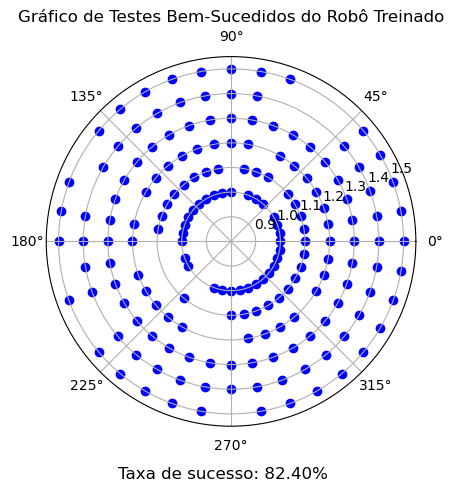

In [13]:
import matplotlib.pyplot as plt

radius, angles = zip(*success_games)

plt.figure()
ax = plt.subplot(111, projection='polar')

scatter = ax.scatter(angles, radius, color='blue')

ax.set_ylim(0.8, 1.55)

ax.set_xticks([0, np.pi/4, np.pi/2, 3*np.pi/4, np.pi, 5*np.pi/4, 3*np.pi/2, 7*np.pi/4])
ax.set_xticklabels(['0°', '45°', '90°', '135°', '180°', '225°', '270°', '315°'])

percentage = len(success_games) / 250 * 100
percentage_formatted = f"{percentage:.2f}%"

plt.figtext(0.5, 0, f'Taxa de sucesso: {percentage_formatted}', ha='center', fontsize=12)

plt.title('Gráfico de Testes Bem-Sucedidos do Robô Treinado')
plt.show()
